In [ ]:
!pip install missingno --quiet
!pip install plotly

In [ ]:
#from google.colab import files
#uploaded = files.upload()

In [ ]:
import os
import sys
import re
import numpy as np               # Performing Mathametical opration
import pandas as pd              # Data processing and dataframe
import matplotlib.pyplot as plt  #Visualisation library
import seaborn as sns            # Visualisation library
import itertools                 # Library to iterate over items.
import missingno as msno         # Specialized Library for Missing Values
from scipy import stats          # Stats library
import plotly.express as px
import warnings as wrn
import plotly.graph_objects as go

wrn.filterwarnings('ignore', category = DeprecationWarning)
wrn.filterwarnings('ignore', category = FutureWarning)
wrn.filterwarnings('ignore', category = UserWarning)

pd.set_option('display.max_columns',None)  #Columns visibility setting
# pd.set_option("display.precision", 2)
pd.options.display.float_format = '{:.5f}'.format #5f diplay five decimal floating
%config InlineBackend.figure_format = 'retina'  # Plotting pretty figures and avoid blurry images
%matplotlib inline

In [ ]:
df_mf = pd.read_csv("/content/Morningstar - European ETFs.csv",skipinitialspace = True)
df_etf = pd.read_csv("/content/Morningstar - European ETFs.csv", skipinitialspace = True)

In [ ]:
df_mf_copy = df_mf.copy(deep = True)

jhjhh

In [ ]:
# Understanding values of feature highlighting country exposure of fund
df_mf['country_exposure'].head(5)

# Observation
# Some funds have invested in multiple countries, so we need to split all countries from each row.


0                                             CHE: 100
1    CHE: 2.606293, FIN: 3.200524, GBR: 3.036105, S...
2    AUS: 1.689256, AUT: 0.353944, BEL: 1.963792, C...
3    AUS: 0.881249, CAN: 1.612178, CHE: 0.107715, D...
4    AUT: 0.681711, BEL: 3.169327, CHN: 0.695045, D...
Name: country_exposure, dtype: object

In [ ]:
df_mf.head()

,ticker,isin,fund_name,morningstar_category,morningstar_rating,morningstar_analyst_rating,morningstar_risk_rating,morningstar_performance_rating,nav_per_share_currency,nav_per_share,class_size_currency,class_size,fund_size_currency,fund_size,fund_return_ytd,fund_return_2018,fund_return_2017,fund_return_2016,fund_return_2015,fund_return_2014,fund_return_2013,fund_return_2012,fund_return_2011,fund_return_2010,investment_strategy,trailing_return_3years,trailing_return_5years,trailing_return_10years,trailing_return_since_inception,dividend_frequency,fund_benchmark,morningstar_benchmark,equity_style,equity_style_score,equity_size,equity_size_score,price_prospective_earnings,price_book,price_sales,price_cash_flow,dividend_yield_factor,long_term_projected_earnings_growth,historical_earnings_growth,sales_growth,cash_flow_growth,book_value_growth,roa,roe,roic,bond_interest_rate_sensitivity,bond_credit_quality,average_coupon_rate,average_credit_quality,modified_duration,effective_maturity,asset_stock,asset_bond,asset_cash,asset_other,country_exposure,top5_regions,sector_basic_materials,sector_consumer_cyclical,sector_financial_services,sector_real_estate,sector_consumer_defensive,sector_healthcare,sector_utilities,sector_communication_services,sector_energy,sector_industrials,sector_technology,market_capitalization_giant,market_capitalization_large,market_capitalization_medium,market_capitalization_small,market_capitalization_micro,credit_quality_aaa,credit_quality_aa,credit_quality_a,credit_quality_bbb,credit_quality_bb,credit_quality_b,credit_quality_below_b,credit_quality_not_rated,holdings_number_stock,holdings_number_bonds,top5_holdings,ongoing_cost,management_fees,sustainability_rank,esg_score,environmental_score,social_score,governance_score,controversy_score,sustainability_score,sustainability_percentage_rank,involvement_abortive_contraceptive,involvement_alcohol,involvement_animal_testing,involvement_controversial_weapons,involvement_gambling,involvement_gmo,involvement_military_contracting,involvement_nuclear,involvement_palm_oil,involvement_pesticides,involvement_small_arms,involvement_thermal_coal,involvement_tobacco
0,0P00000C5S,CH0008899764,iShares SMI® (CH),Switzerland Large-Cap Equity,3.00000,Neutral,3.00000,3.00000,CHF,103.80000,CHF,1952560000,CHF,1952560000,20.84000,-2.77000,11.71000,12.96000,6.20000,6.93000,24.71000,15.29000,-4.09000,15.18000,The Fund aims to achieve a return on your inve...,8.60000,10.99000,NaN,NaN,Annually,SIX SMI TR CHF,MSCI Switzerland NR CHF,Growth,180.27000,Large,342.02000,18.37000,2.54000,2.16000,14.91000,3.18000,8.64000,14.99000,0.97000,4.82000,-0.19000,7.51000,20.47000,14.29000,NaN,NaN,NaN,NaN,NaN,NaN,99.85000,0.00000,0.15000,0.00000,CHE: 100,Europe - Ex Euro: 100,8.93000,4.80000,18.53000,NaN,17.60000,42.89000,NaN,1.37000,NaN,5.89000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.00000,NaN,"Roche: 19.46, Novartis AG: 17.70, Nestle SA: 1...",0.35000,0.00000,3.00000,64.68000,64.18000,63.00000,60.92000,9.69000,54.99000,60.00000,39.32000,0.00000,62.11000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,3.99000,0.00000,0.00000
1,0P00000FYY,SE0000693293,XACT OMXS30 UCITS ETF,Sweden Equity,2.00000,NaN,3.00000,2.00000,SEK,209.50000,SEK,7641050000,SEK,7707150000,11.08000,-8.91000,8.41000,20.77000,0.68000,-1.02000,24.10000,17.54000,-13.42000,36.46000,The investment seeks to track the price and pe...,3.46000,7.59000,NaN,6.04000,NaN,NASDAQ OMX Stockholm 30 GR SEK_a,MSCI Sweden NR SEK,Blend,140.59000,Large,239.43000,16.00000,2.12000,1.68000,14.01000,4.42000,6.09000,11.91000,1.86000,-0.79000,3.12000,6.34000,16.93000,11.92000,NaN,NaN,NaN,NaN,NaN,NaN,100.03000,0.00000,-0.03000,0.00000,"CHE: 2.606293, FIN: 3.200524, GBR: 3.036105, S...","Europe - Ex Euro: 93.76, Eurozone: 3.2, United...",3.19000,8.18000,23.81000,NaN,6.39000,3.92000,NaN,7.16000,NaN,35.29000,12.05000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30.00000,NaN,"Hennes & Mauritz AB B: 7.05, Atlas Copco AB A:...",0.10000,0.

In [ ]:
import plotly.graph_objects as go
mf_geo_copy = df_mf.copy()

# Extract country codes from each row in the 'country_exposure' column
mf_all_country_codes = mf_geo_copy['country_exposure'].str.findall(r'([A-Z]{3}):')

# Flatten the list of lists into a single list
mf_all_country_codes = [code for codes_list in mf_all_country_codes.dropna() for code in codes_list]

# Remove -99 from the list-Ignore
mf_all_country_codes = [code for code in mf_all_country_codes if code != '-99']

# Count the frequency of each country code
mf_country_code_counts = pd.Series(mf_all_country_codes).value_counts().reset_index().rename(columns={'index': 'Country Code', 0: 'Frequency'})

# Create a Geo Heatmap using Plotly
fig = go.Figure(go.Choropleth(
    locations=mf_country_code_counts['Country Code'],
    z=mf_country_code_counts['Frequency'],
    text=mf_country_code_counts['Country Code'],
    colorscale='Viridis',
    colorbar_title='Frequency of Country Codes',
    marker_line_color='white',  # Add white border lines for better visibility
    marker_line_width=0.5,
))

fig.update_layout(
    title_text='Geographic Investments in Fund Portfolios',
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='natural earth',
        bgcolor='lightblue',  # Set background color
    ),
    margin=dict(l=0, r=0, b=0, t=40),  # Adjust margin for better layout
)

fig.show()

# To print all values of country and frequency associated with it.
# for index, row in mf_country_code_counts.iterrows():
# print(f"Country: {row['Country Code']}, Frequency: {row['Frequency']}")


In [ ]:
etf_geo_copy = df_etf.copy()

# Extract country codes from each row in the 'country_exposure' column
etf_all_country_codes = etf_geo_copy['country_exposure'].str.findall(r'([A-Z]{3}):')

# Flatten the list of lists into a single list
etf_all_country_codes = [code for codes_list in etf_all_country_codes.dropna() for code in codes_list]

# Remove -99 from the list-Ignore
etf_all_country_codes = [code for code in etf_all_country_codes if code != '-99']

# Count the frequency of each country code
etf_country_code_counts = pd.Series(etf_all_country_codes).value_counts().reset_index().rename(columns={'index': 'Country Code', 0: 'Frequency'})

# Create a Geo Heatmap using Plotly
fig = go.Figure(go.Choropleth(
    locations=etf_country_code_counts['Country Code'],
    z=etf_country_code_counts['Frequency'],
    text=etf_country_code_counts['Country Code'],
    colorscale='Viridis',
    colorbar_title='Frequency of Country Codes',
    marker_line_color='white',  # Add white border lines for better visibility
    marker_line_width=0.5,
))

fig.update_layout(
    title_text='Geographic Investments in ETF Portfolios',
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='natural earth',
        bgcolor='lightblue',  # Set background color
    ),
    margin=dict(l=0, r=0, b=0, t=40),  # Adjust margin for better layout
)

fig.show()

# To print all values of country and frequency associated with it.
# for index, row in etf_country_code_counts.iterrows():
#     print(f"Country: {row['Country Code']}, Frequency: {row['Frequency']}")


#Correlation between MF & ETF based on Data


In [ ]:
pd.concat([df_mf, df_etf], axis = 1, keys = ['df_mf', 'df_etf']).corr().loc['df_mf', 'df_etf'][0:10] #[Row][Columns]

,morningstar_rating,morningstar_risk_rating,morningstar_performance_rating,nav_per_share,class_size,fund_size,fund_return_ytd,fund_return_2018,fund_return_2017,fund_return_2016,fund_return_2015,fund_return_2014,fund_return_2013,fund_return_2012,fund_return_2011,fund_return_2010,trailing_return_3years,trailing_return_5years,trailing_return_10years,trailing_return_since_inception,equity_style_score,equity_size_score,price_prospective_earnings,price_book,price_sales,price_cash_flow,dividend_yield_factor,long_term_projected_earnings_growth,historical_earnings_growth,sales_growth,cash_flow_growth,book_value_growth,roa,roe,roic,average_coupon_rate,average_credit_quality,modified_duration,effective_maturity,asset_stock,asset_bond,asset_cash,asset_other,sector_basic_materials,sector_consumer_cyclical,sector_financial_services,sector_real_estate,sector_consumer_defensive,sector_healthcare,sector_utilities,sector_communication_services,sector_energy,sector_industrials,sector_technology,market_capitalization_giant,market_capitalization_large,market_capitalization_medium,market_capitalization_small,market_capitalization_micro,credit_quality_aaa,credit_quality_aa,credit_quality_a,credit_quality_bbb,credit_quality_bb,credit_quality_b,credit_quality_below_b,credit_quality_not_rated,holdings_number_stock,holdings_number_bonds,ongoing_cost,management_fees,sustainability_rank,esg_score,environmental_score,social_score,governance_score,controversy_score,sustainability_score,sustainability_percentage_rank,involvement_abortive_contraceptive,involvement_alcohol,involvement_animal_testing,involvement_controversial_weapons,involvement_gambling,involvement_gmo,involvement_military_contracting,involvement_nuclear,involvement_palm_oil,involvement_pesticides,involvement_small_arms,involvement_thermal_coal,involvement_tobacco
morningstar_rating,1.00000,-0.05553,0.94897,0.02615,0.05816,0.00613,0.30579,0.14203,0.04585,0.06205,0.25993,0.28870,0.16907,0.00639,0.37144,0.07089,0.27640,0.44303,NaN,0.44071,0.23304,0.19811,0.31073,0.41407,0.17827,0.25683,-0.28986,-0.00671,0.09375,0.08946,0.11456,0.03079,0.37003,0.42173,0.37059,0.01277,0.13868,0.42861,0.39267,0.07824,-0.02077,-0.05673,-0.09381,-0.20747,0.01265,-0.22127,-0.04846,0.04748,0.04796,0.01544,-0.10674,-0.12214,0.12223,0.08019,0.11463,0.22408,-0.08836,-0.25931,-0.12868,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.05011,0.03792,-0.17531,-0.07043,0.06031,0.09458,0.12391,0.06662,0.00567,0.05836,0.08151,-0.05940,0.04291,0.03521,0.03345,0.18453,-0.06663,-0.01794,0.14208,0.08389,0.00993,-0.06954,0.00295,-0.02814,-0.03352
morningstar_risk_rating,-0.05553,1.00000,0.03741,-0.05402,-0.06658,-0.07320,-0.02819,-0.10544,0.07798,0.14136,-0.29747,-0.15851,-0.18538,0.05084,-0.27277,-0.02899,-0.03251,-0.19995,NaN,-0.22161,-0.11137,-0.01999,-0.21787,-0.13941,-0.01866,-0.13445,0.16982,0.09283,0.11444,0.01990,0.07935,-0.04393,-0.15501,-0.18049,-0.13345,-0.06146,-0.25494,0.37617,0.48067,0.00005,-0.00409,-0.03225,0.00978,0.21462,0.14829,0.20783,0.07672,-0.14446,-0.05902,0.03462,0.06985,0.18678,-0.12545,0.06633,-0.08237,0.01275,0.06357,0.03560,0.14324,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.21164,0.04173,0.09987,-0.02805,-0.03635,0.03849,0.02267,0.06143,0.09035,0.06368,0.01444,0.02519,-0.03493,0.07674,-0.05686,0.02463,-0.01930,0.01142,0.01143,-0.07682,0.03222,0.06266,0.05078,0.07129,-0.06832
morningstar_performance_rating,0.94897,0.03741,1.00000,0.02096,0.04601,0.00013,0.31254,0.11607,0.05481,0.10266,0.22777,0.25411,0.13732,0.01531,0.32778,0.09979,0.27532,0.42697,NaN,0.41985,0.20933,0.20423,0.28657,0.38949,0.17057,0.24283,-0.25779,0.01118,0.14152,0.10018,0.12201,0.03101,0.36112,0.40657,0.36599,-0.01160,0.09206,0.42892,0.37813,0.08610,-0.03875,-0.04489,-0.08187,-0.13848,0.03005,-0.20040,-0.04295,0.04129,0.02991,0.01126,-0.11196,-0.07774,0.09721,0.08402,0.12934,0.27004,-0.10781,-0.29776,-0.13959,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.02173,0.04336,-0.14695,-0.06244,0.06043,0.10083,0.12067,0.07640,0.01900,0.06519,0.08552,-0.05574,0.03306,0.03569,0.03212

Visual Representation of co-relation

why we establish co-relation?

The correlation coefficient is a statistical measure that quantifies the degree to which two variables move in relation to each other. It ranges from -1 to 1, with the following interpretations:

1: Perfect positive correlation. If one variable increases, the other variable also increases proportionally.

0: No correlation. There is no linear relationship between the two variables.

-1: Perfect negative correlation. If one variable increases, the other variable decreases proportionally.


In [ ]:
corr_matrix=pd.concat([df_mf, df_etf], axis = 1, keys = ['df_mf', 'df_etf']).corr().loc['df_mf', 'df_etf'].iloc[:10, :10] # Select necessary rows and column to visualize desired co-relation

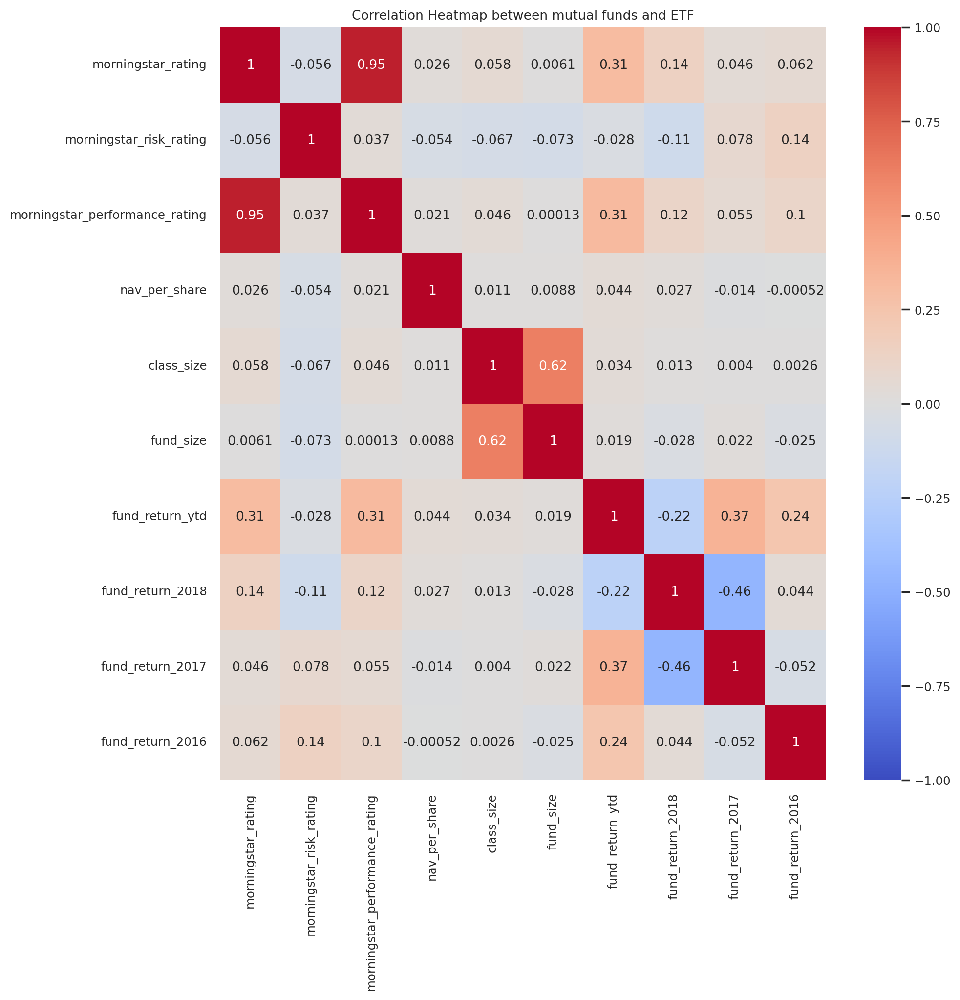

In [ ]:
plt.figure(figsize=(10,10))
sns.set(font_scale=0.8)
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Heatmap between mutual funds and ETF')
plt.show()

**Result**

1.   Initially, it seems like the features in both datasets share similar names, but there isn't a strong positive connection between them.

2.   This indicates that Mutual Funds (MF) and Exchange-Traded Funds (ETF) are distinct instruments with different characteristics.

3.  Key Differences:

    i.    Trading Approach: MFs trade at the closing net asset value, while ETFs trade throughout the day, causing value changes.

    ii. Tax Impact: Generally, MFs face higher taxes compared to ETFs, with some exceptions.

    iii. Liquidity: Mutual Funds are less liquid than ETFs.

    iv. Management Costs: MFs have higher expenses due to active management, while ETFs, tracking an index, require less hands-on management.

**Data Preprocessing and EDA**


DATA PREPROCESSING CHECKLIST

* **Segregating the target variable and segregating numerical and categorical variables**

* **Type Casting of Variables:**

  Ensure that variables have the correct data type. For example, converting numerical variables stored as strings to actual numeric types.


* **Handling Missing Values - Drop / Impute:**

  Dealing with missing data, either by removing rows or columns with missing values, or by filling in the missing values with imputation methods.


* **Handling Outliers - Drop / Capping, Flooring:**

  Addressing outliers in the data. This can involve removing extreme values, capping or flooring them (replacing extreme values with a predefined threshold).


* **Remove Duplicate Values:**

  Identifying and removing duplicate records in the dataset.


* **Feature Scaling of High-Range Variables:**

  Scaling numerical features, especially when they have different ranges, to ensure that they contribute equally to the analysis. Common scaling methods include normalization and standardization.


* **Categorical Encoding of Categorical Features:**

  Converting categorical variables into a numerical format that can be used by machine learning algorithms. Common techniques include one-hot encoding, label encoding, or binary encoding.


* **Feature Selection based on Multi-collinearity, Zero or Low Variance:**

  Selecting a subset of relevant features based on criteria such as multicollinearity (correlation between independent variables), zero or low variance (features with little variability).

**Segregating** Dataset


1.Segregating Target Variable from Predictors.

2.Segregating Numerical Variables from Categorical Variables.

In [ ]:
df_mf_num = df_mf.select_dtypes(include = 'number')
df_mf_cat = df_mf.select_dtypes(include = ['object','category'])

**What is Target Variable and Predictors:**

In a dataset, you typically have variables that you want to predict or explain. The variable you want to predict is called the **target variable**.

The other variables that you use to make predictions or estimates about the target variable are called **predictors or features**.

Nature of Target variable is Continous numbers.It is essentially, a Supervised Regression problem.


**For example**, if you're trying to predict the price of a house, the price would be the target variable, and predictors could include features like the number of bedrooms, square footage, location, etc.

---



---




**What is Numerical Variables and Categorical Variables.**

**Numerical Variables:**

Numerical variables represent measurable quantities and can take on numerical values, such as age, income, or temperature.
They can be either continuous (e.g., height) or discrete (e.g., number of siblings).

**Categorical Variables:**

Categorical variables represent categories or labels, like gender, color, or country.
They can be nominal (with no inherent order) or ordinal (with a meaningful order).

**Segregating Numerical Variables from Categorical Variables:**

Machine learning models often treat numerical and categorical variables differently, so it's crucial to segregate them during data preprocessing.
Numerical variables are usually used as-is, while categorical variables need to be converted into a numerical format through encoding methods like one-hot encoding or label encoding.
This segregation ensures that the model can appropriately handle and interpret both types of variables during training and testing.

In [ ]:
# Understanding MF dataframe -Help with initial understanding of Data
df_mf.sample(5)

# Initial Observation:
# 1.Many values of some features are missing in dataframe. i.e. Ratings.
# 2.Features like "ticker" and "isin" looks like identifier and Unique.-Will confirm later.
# 3."Investment strategy" has variable info and quite lenghty and complex-Will Check uniqueness or Drop. Can check investment styles are unique or not
# 30002 and numbers in exterme left are row nos.

,ticker,isin,fund_name,morningstar_category,morningstar_rating,morningstar_analyst_rating,morningstar_risk_rating,morningstar_performance_rating,nav_per_share_currency,nav_per_share,class_size_currency,class_size,fund_size_currency,fund_size,fund_return_ytd,fund_return_2018,fund_return_2017,fund_return_2016,fund_return_2015,fund_return_2014,fund_return_2013,fund_return_2012,fund_return_2011,fund_return_2010,investment_strategy,trailing_return_3years,trailing_return_5years,trailing_return_10years,trailing_return_since_inception,dividend_frequency,fund_benchmark,morningstar_benchmark,equity_style,equity_style_score,equity_size,equity_size_score,price_prospective_earnings,price_book,price_sales,price_cash_flow,dividend_yield_factor,long_term_projected_earnings_growth,historical_earnings_growth,sales_growth,cash_flow_growth,book_value_growth,roa,roe,roic,bond_interest_rate_sensitivity,bond_credit_quality,average_coupon_rate,average_credit_quality,modified_duration,effective_maturity,asset_stock,asset_bond,asset_cash,asset_other,country_exposure,top5_regions,sector_basic_materials,sector_consumer_cyclical,sector_financial_services,sector_real_estate,sector_consumer_defensive,sector_healthcare,sector_utilities,sector_communication_services,sector_energy,sector_industrials,sector_technology,market_capitalization_giant,market_capitalization_large,market_capitalization_medium,market_capitalization_small,market_capitalization_micro,credit_quality_aaa,credit_quality_aa,credit_quality_a,credit_quality_bbb,credit_quality_bb,credit_quality_b,credit_quality_below_b,credit_quality_not_rated,holdings_number_stock,holdings_number_bonds,top5_holdings,ongoing_cost,management_fees,sustainability_rank,esg_score,environmental_score,social_score,governance_score,controversy_score,sustainability_score,sustainability_percentage_rank,involvement_abortive_contraceptive,involvement_alcohol,involvement_animal_testing,involvement_controversial_weapons,involvement_gambling,involvement_gmo,involvement_military_contracting,involvement_nuclear,involvement_palm_oil,involvement_pesticides,involvement_small_arms,involvement_thermal_coal,involvement_tobacco
403,0P0000I5AI,IE00B0M63177,iShares MSCI EM UCITS ETF USD (Dist),Global Emerging Markets Equity,3.00000,Neutral,3.00000,3.00000,GBX,3070.50000,USD,3561010000,USD,3561010000,6.42000,-9.61000,24.47000,33.76000,-11.67000,2.87000,-5.73000,11.62000,-18.88000,23.85000,The investment objective of this Fund is to pr...,4.44000,7.52000,NaN,NaN,Quarterly,MSCI EM NR USD,MSCI EM NR USD,Blend,145.85000,Large,318.56000,12.26000,1.41000,1.11000,4.41000,3.69000,8.26000,8.31000,6.84000,7.15000,6.74000,6.78000,16.18000,9.85000,NaN,NaN,7.24000,NaN,NaN,NaN,99.35000,0.00000,0.65000,0.00000,"ARE: 0.697384, ARG: 0.133302, BEL: 0.016689, B...","Asia - Emerging: 48.16, Asia - Developed: 24.2...",7.74000,11.68000,24.62000,3.07000,7.12000,2.52000,2.66000,4.74000,7.44000,4.92000,23.50000,55.23000,31.61000,12.00000,1.15000,0.01000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1033.00000,1.00000,"Alibaba Group Holding Ltd ADR: 4.51, Tencent H...",0.75000,0.00000,3.00000,49.57000,50.85000,50.49000,48.31000,4.64000,44.93000,52.00000,1.77000,1.03000,3.63000,0.22000,0.19000,0.04000,0.17000,0.24000,0.54000,0.09000,0.00000,5.40000,0.63000
6725,0P0001D5I3,LU1681037948,Amundi Index Solutions - Amundi Japan Topix UC...,Other Equity,NaN,NaN,NaN,NaN,USD,64.15000,USD,6780000,EUR,915420000,13.58000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"To track the performance of TOPIX Index, and t...",NaN,NaN,NaN,NaN,NaN,TOPIX TR JPY,NaN,Blend,139.16000,Large,304.15000,13.83000,1.31000,1.06000,6.57000,3.62000,8.80000,4.95000,-0.22000,0.14000,5.81000,4.12000,12.14000,8.20000,NaN,NaN,NaN,NaN,NaN,NaN,101.99000,-1.32000,-0.67000,0.00000,"DEU: 26.011378, ESP: 6.878149, FRA: 36.025874,...","Eurozone: 77.05, Japan: 17.87, United Kingdom:...",3.22000,10.21000,17.93000,1.01000,4.04000,22.42000,1.93000,6.35000,9.22000,13.75000,9.91000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,68.00000

In [ ]:
display(df_mf.shape,
        df_mf_num.shape,
        df_mf_cat.shape)  # Helps in differentiating features as Numerical or Catergorical

# Observation
# In mutual fund data set-out of 132 features,110 are numerical and 22 are Categorial.
# Will Check which features are categorical and Numerical in Dataset.
# There might me instance of of "Numerical" feature being "Categorical"

(8143, 111)

(8143, 92)

(8143, 19)

In [ ]:
# Summary of MF df  -Visual and detailed summary of features in categorical and Numerical data.
df_mf.info(verbose=False, memory_usage=False)
print("\n "+"Numerical variables")
display(df_mf.select_dtypes(include='number').describe())
print("\n"+"Categorial Variables")
display(df_mf.select_dtypes(include=['object', 'category']).describe())

# Observation

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8143 entries, 0 to 8142
Columns: 111 entries, ticker to involvement_tobacco
dtypes: float64(90), int64(2), object(19)
 Numerical variables


,morningstar_rating,morningstar_risk_rating,morningstar_performance_rating,nav_per_share,class_size,fund_size,fund_return_ytd,fund_return_2018,fund_return_2017,fund_return_2016,fund_return_2015,fund_return_2014,fund_return_2013,fund_return_2012,fund_return_2011,fund_return_2010,trailing_return_3years,trailing_return_5years,trailing_return_10years,trailing_return_since_inception,equity_style_score,equity_size_score,price_prospective_earnings,price_book,price_sales,price_cash_flow,dividend_yield_factor,long_term_projected_earnings_growth,historical_earnings_growth,sales_growth,cash_flow_growth,book_value_growth,roa,roe,roic,average_coupon_rate,average_credit_quality,modified_duration,effective_maturity,asset_stock,asset_bond,asset_cash,asset_other,sector_basic_materials,sector_consumer_cyclical,sector_financial_services,sector_real_estate,sector_consumer_defensive,sector_healthcare,sector_utilities,sector_communication_services,sector_energy,sector_industrials,sector_technology,market_capitalization_giant,market_capitalization_large,market_capitalization_medium,market_capitalization_small,market_capitalization_micro,credit_quality_aaa,credit_quality_aa,credit_quality_a,credit_quality_bbb,credit_quality_bb,credit_quality_b,credit_quality_below_b,credit_quality_not_rated,holdings_number_stock,holdings_number_bonds,ongoing_cost,management_fees,sustainability_rank,esg_score,environmental_score,social_score,governance_score,controversy_score,sustainability_score,sustainability_percentage_rank,involvement_abortive_contraceptive,involvement_alcohol,involvement_animal_testing,involvement_controversial_weapons,involvement_gambling,involvement_gmo,involvement_military_contracting,involvement_nuclear,involvement_palm_oil,involvement_pesticides,involvement_small_arms,involvement_thermal_coal,involvement_tobacco
count,5264.00000,5264.00000,5264.00000,8143.00000,8143.00000,8143.00000,7473.00000,5444.00000,4755.00000,4046.00000,3420.00000,2930.00000,2574.00000,2231.00000,1807.00000,999.00000,4587.00000,3249.00000,1.00000,327.00000,5406.00000,5406.00000,5406.00000,5406.00000,5406.00000,5406.00000,5406.00000,5390.00000,5394.00000,5377.00000,5250.00000,5377.00000,5369.00000,5369.00000,4937.00000,2248.00000,379.00000,305.00000,361.00000,8143.00000,8143.00000,8143.00000,8143.00000,4548.00000,4762.00000,4581.00000,3936.00000,4487.00000,4301.00000,4162.00000,4374.00000,4124.00000,4750.00000,4579.00000,1080.00000,1080.00000,1080.00000,1080.00000,1080.00000,4.00000,4.00000,4.00000,4.00000,4.00000,4.00000,4.00000,4.00000,4180.00000,2047.00000,7689.00000,7847.00000,4598.00000,4844.00000,4844.00000,4844.00000,4844.00000,4860.00000,4844.00000,4706.00000,5043.00000,5043.00000,5043.00000,5043.00000,5043.00000,5043.00000,5043.00000,5043.00000,5043.00000,5043.00000,5043.00000,5043.00000,5043.00000
mean,3.43940,2.99240,3.44586,778.14984,1009702400.82070,2539595575.32703,10.10806,-5.42288,10.77043,25.48892,-0.69305,4.00714,10.99659,9.59105,-8.62485,11.66128,4.68586,8.11155,0.07000,7.17820,144.72203,268.41112,15.26797,2.02737,1.58814,7.81155,3.33458,8.60513,9.74926,4.17187,6.15914,4.22307,6.27408,17.89448,11.43953,3.13097,8.16359,6.86207,7.71186,65.51907,20.35695,1.10187,13.02194,9.16626,13.09641,21.76983,7.48188,10.71830,11.09563,6.16024,5.12837,8.31719,11.86808,16.29388,38.28270,32.67968,21.04339,6.12851,1.86642,4.51000,16.57000,23.64000,47.89000,2.84000,4.29000,0.20000,0.06000,330.22967,522.41329,0.33842,0.19875,3.42214,55.79402,56.18569,55.56747,53.86254,6.03764,49.75353,39.93179,5.03143,1.73676,15.76252,1.18286,0.33914,0.03612,1.54142,2.25630,0.10245,1.10704,0.21646,4.86380,0.77821
std,0.98869,1.01889,0.96633,4273.29163,7445080386.57000,21537830943.19373,10.52257,11.61783,11.18857,15.36623,11.13104,13.17690,19.73802,23.77815,26.87840,15.43820,6.95528,6.54076,NaN,6.00117,42.69535,64.15552,3.61607,1.04019,1.10338,3.35713,1.37252,2.40492,12.28919,5.05956,9.12479,7.93889,2.71839,6.94271,4.60372,1.95918,3.84001,3.50025,4.05994,47.33631,39.49905,10.38333,33.48286,


Categorial Variables


,ticker,isin,fund_name,morningstar_category,morningstar_analyst_rating,nav_per_share_currency,class_size_currency,fund_size_currency,investment_strategy,dividend_frequency,fund_benchmark,morningstar_benchmark,equity_style,equity_size,bond_interest_rate_sensitivity,bond_credit_quality,country_exposure,top5_regions,top5_holdings
count,8143,8143,8143,8143,1149,8143,8143,8143,8021,1709,7428,6716,5406,5406,379,379,7083,7133,8143
unique,8143,2211,2118,178,5,13,12,12,1395,3,986,152,3,3,3,3,1624,1359,1272
top,0P00000C5S,LU0136240974,UBS ETF - EURO STOXX 50 UCITS ETF (EUR) A-dis,Other Equity,Neutral,EUR,USD,USD,The Fund seeks to achieve long term capital ap...,Annually,S&P 500 NR USD,Russell 1000 TR USD,Blend,Large,High,Medium,USA: 100,United States: 100,"TRS: 100.00, TRS: 100"
freq,1,11,11,587,354,4891,3850,4054,28,1331,130,503,3192,4650,216,216,426,468,932


In [ ]:
df_mf_num.nunique().sort_values(ascending = True)[0:15]
# Top 15 Features with unique values in ascending order

# Psudo Categorical Variables  - MF
# rating                                 5
# risk_rating                            5
# performance_rating                     5
# sustainability_rank                    5
# average_credit_quality                18
# quarters_down                         20
# quarters_up                           24
# sustainability_percentage_rank       100
# involvement_gmo                      162
# involvement_palm_oil                 197
# involvement_small_arms               386
# involvement_pesticides               386
# involvement_controversial_weapons    480
# involvement_gambling                 523

credit_quality_below_b             1
credit_quality_aaa                 1
trailing_return_10years            1
credit_quality_aa                  1
credit_quality_a                   1
credit_quality_bbb                 1
credit_quality_bb                  1
credit_quality_b                   1
credit_quality_not_rated           1
morningstar_rating                 5
morningstar_performance_rating     5
morningstar_risk_rating            5
sustainability_rank                5
average_credit_quality            13
involvement_gmo                   40
dtype: int64

In [ ]:
df_mf_cat.nunique().sort_values(ascending = True)[0:15]

dividend_frequency                   3
bond_credit_quality                  3
bond_interest_rate_sensitivity       3
equity_size                          3
equity_style                         3
morningstar_analyst_rating           5
class_size_currency                 12
fund_size_currency                  12
nav_per_share_currency              13
morningstar_benchmark              152
morningstar_category               178
fund_benchmark                     986
top5_holdings                     1272
top5_regions                      1359
investment_strategy               1395
dtype: int64

In [ ]:
print(df_mf_cat.columns.values)

# Observation:

# Categorical variables

#  ['ticker' 'isin' 'fund_name' 'inception_date' 'category' 'analyst_rating'
#  'investment_strategy' 'investment_managers' 'dividend_frequency'
#  'fund_benchmark' 'morningstar_benchmark' 'equity_style' 'equity_size'
#  'bond_interest_rate_sensitivity' 'bond_credit_quality' 'country_exposure'
#  'latest_nav_date' 'nav_per_share_currency' 'shareclass_size_currency'
#  'fund_size_currency' 'top5_regions' 'top5_holdings']

# Categorical variable with lesser class
# bond_credit_quality                  3
# bond_interest_rate_sensitivity       3
# equity_size                          3
# equity_style                         3
# dividend_frequency                   6
# analyst_rating                       6
# fund_size_currency                  14

# Pseudo Categorical Variables
# rating                                 5
# risk_rating                            5
# performance_rating                     5
# sustainability_rank                    5
# average_credit_quality                18
# quarters_down                         20
# quarters_up                           24
# sustainability_percentage_rank       100
# involvement_gmo                      162
# involvement_palm_oil                 197
# involvement_small_arms               386
# involvement_pesticides               386
# involvement_controversial_weapons    480
# involvement_gambling


['ticker' 'isin' 'fund_name' 'morningstar_category'
 'morningstar_analyst_rating' 'nav_per_share_currency'
 'class_size_currency' 'fund_size_currency' 'investment_strategy'
 'dividend_frequency' 'fund_benchmark' 'morningstar_benchmark'
 'equity_style' 'equity_size' 'bond_interest_rate_sensitivity'
 'bond_credit_quality' 'country_exposure' 'top5_regions' 'top5_holdings']


Note:

1. Not all "Object" dtype variables are Categorical,Since no. of classes are way beyond to recognize as Categorical.

2. Conversly, not all "float","int" dtype varialbles are Numerical since it has no. classes to be qualify as Categorical variables.

3. To identify Categorical features with dtype "int","float" extract the no. of UNIQUE values from object,float and int variables.

4. Short-list the variables across all dtypes which has the no. of unique values qualified to be a Categorical variables.

5. Create a variable of such short-listed features for further EDA and pre - processing.
For convveinence purpose, I will create 4 (2 each for MF & ETF) new variables, 1 which have variables where unique values =< 20 and other where unique values > 20.

6. Variables Creating a new variable which contains features having no. of unique values < 20. - MF Creating a new variable which contains features having no. of unique values > 20. - MF

7. Creating a new variable which contains features having no. of unique values < 20. - ETF Creating a new variable which contains features having no. of unique values > 20. - ETF

In [ ]:
# Creating a new variable which contains features having no. of unique values < 20. - MF
mf_small_cat = df_mf[["morningstar_analyst_rating", "dividend_frequency", "equity_style", "equity_size" ,
                      "bond_interest_rate_sensitivity" , "bond_credit_quality", "fund_size_currency", "morningstar_rating",
                      "morningstar_risk_rating", "morningstar_performance_rating", "average_credit_quality", "sustainability_rank"]].copy()

In [ ]:
display(mf_small_cat.shape,
mf_small_cat.size,
mf_small_cat.sample(5))

(8143, 12)

97716

,morningstar_analyst_rating,dividend_frequency,equity_style,equity_size,bond_interest_rate_sensitivity,bond_credit_quality,fund_size_currency,morningstar_rating,morningstar_risk_rating,morningstar_performance_rating,average_credit_quality,sustainability_rank
61,NaN,NaN,NaN,NaN,NaN,NaN,EUR,NaN,NaN,NaN,NaN,NaN
3546,NaN,NaN,Value,Small,NaN,NaN,USD,1.00000,4.00000,2.00000,NaN,3.00000
31,NaN,NaN,NaN,NaN,NaN,NaN,SEK,NaN,NaN,NaN,NaN,NaN
5955,NaN,NaN,NaN,NaN,NaN,NaN,USD,NaN,NaN,NaN,NaN,4.00000
1678,NaN,NaN,Blend,Large,NaN,NaN,GBP,NaN,NaN,NaN,NaN,3.00000


In [ ]:
# Creating a new variable which contains features having no. of unique values > 20. - MF

mf_big_cat = df_mf[["nav_per_share_currency", "nav_per_share", "morningstar_benchmark", "involvement_palm_oil",
                    "involvement_gmo", "sustainability_percentage_rank"]].copy()#, '"quarters_up"'

In [ ]:
mf_big_cat.shape
mf_big_cat.size
mf_big_cat.sample(5)

,nav_per_share_currency,nav_per_share,morningstar_benchmark,involvement_palm_oil,involvement_gmo,sustainability_percentage_rank
1678,GBX,5622.00000,NaN,0.01000,0.05000,36.00000
6960,GBX,2090.00000,FSE DAX TR EUR,0.00000,0.00000,33.00000
1504,USD,44.44000,MSCI EM NR USD,NaN,NaN,NaN
3025,EUR,116.00000,MSCI EMU NR EUR,0.00000,0.00000,16.00000
2534,GBX,898.75000,MSCI EM NR USD,NaN,NaN,NaN


In [ ]:
# Describing Categorical Variables  - MF
df_mf_cat.describe(include = "O").T

,count,unique,top,freq
ticker,8143,8143,0P00000C5S,1
isin,8143,2211,LU0136240974,11
fund_name,8143,2118,UBS ETF - EURO STOXX 50 UCITS ETF (EUR) A-dis,11
morningstar_category,8143,178,Other Equity,587
morningstar_analyst_rating,1149,5,Neutral,354
nav_per_share_currency,8143,13,EUR,4891
class_size_currency,8143,12,USD,3850
fund_size_currency,8143,12,USD,4054
investment_strategy,8021,1395,The Fund seeks to achieve long term capital ap...,28
dividend_frequency,1709,3,Annually,1331


**Note into Categorical into -**

NOMINAL

ORDINAL

BINARY

1. There are No Binary features.
2. Following are Ordinal features

  i. bond_credit_quality

  ii. bond_interest_rate_sensitivity

  iii. equity_size

  iv. analyst_rating

  v. rating

  vi. risk_rating

  vii. performance_rating

  viii. sustainability_rank

  ix. average_credit_quality

  x. quarters_down

  xi. quarters_up

  xii. sustainability_percentage_rank

Other than above, all are Nominal features.


---


**FYI:**

**Nominal Feature**: Categories have no inherent order.

Examples: Colors, Country names.
Analysis: Suitable for categorical data, often one-hot encoded.

**Ordinal Feature**: Categories have a meaningful order.

Examples: Education levels, Survey responses.
Analysis: Order matters, intervals may not be uniform.

**Sparse Category Occurrence Chart -MF**.
--

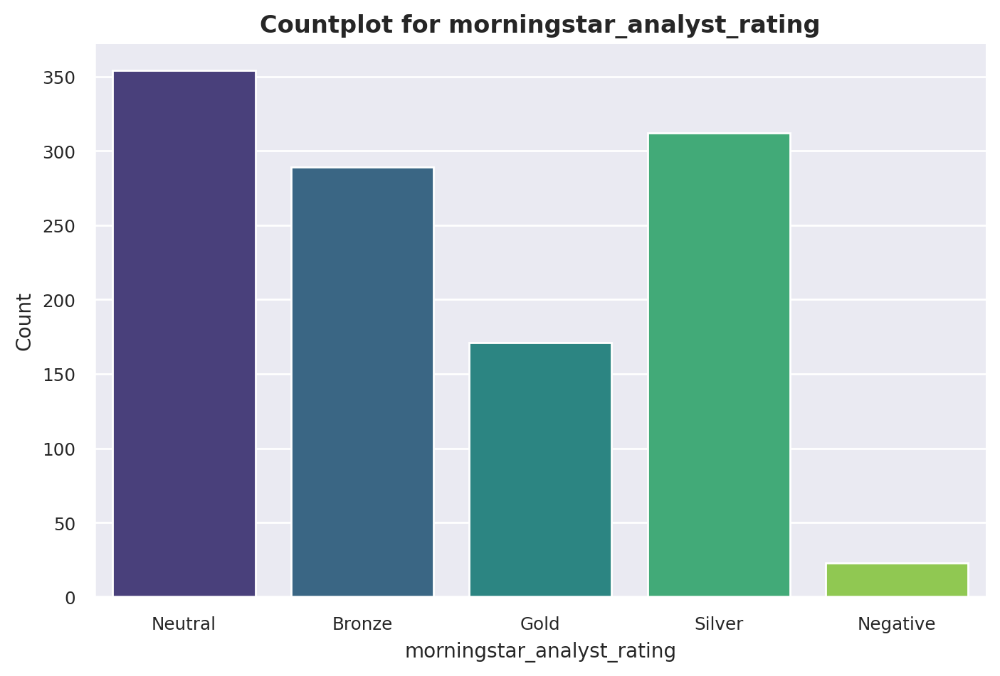

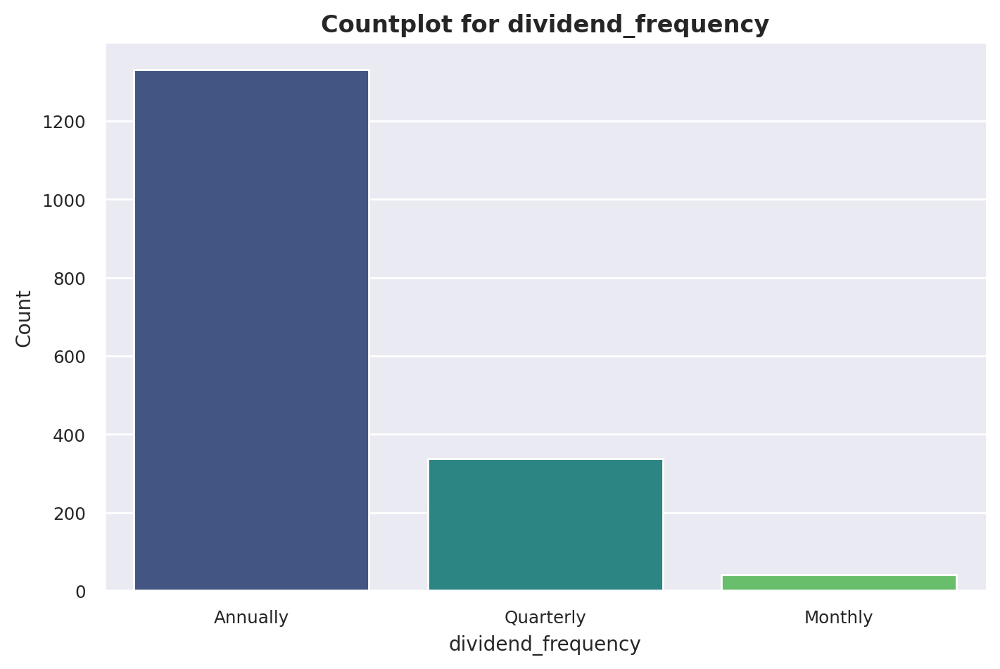

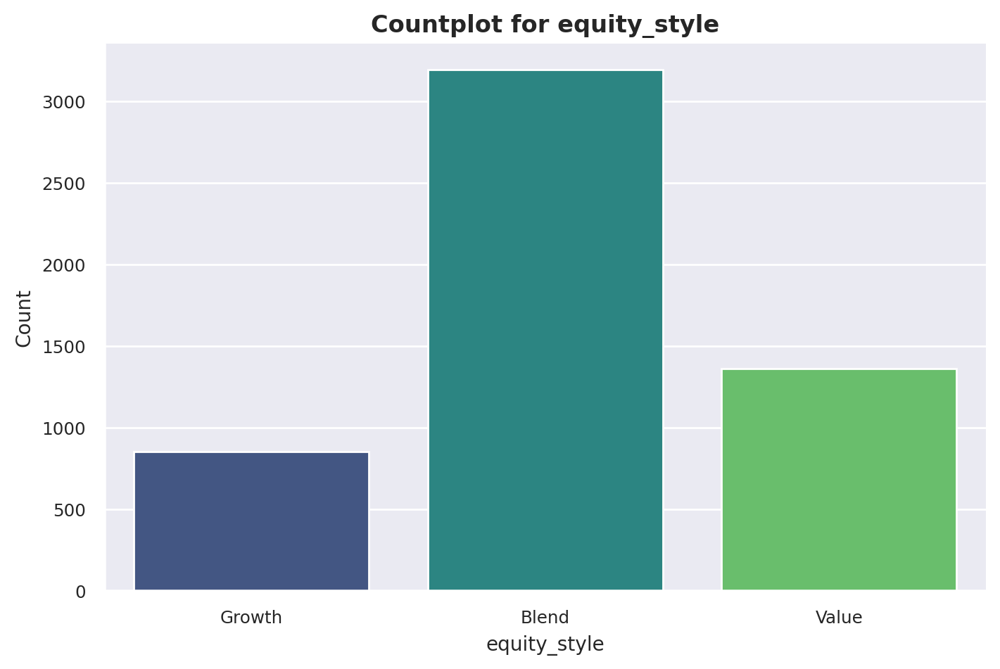

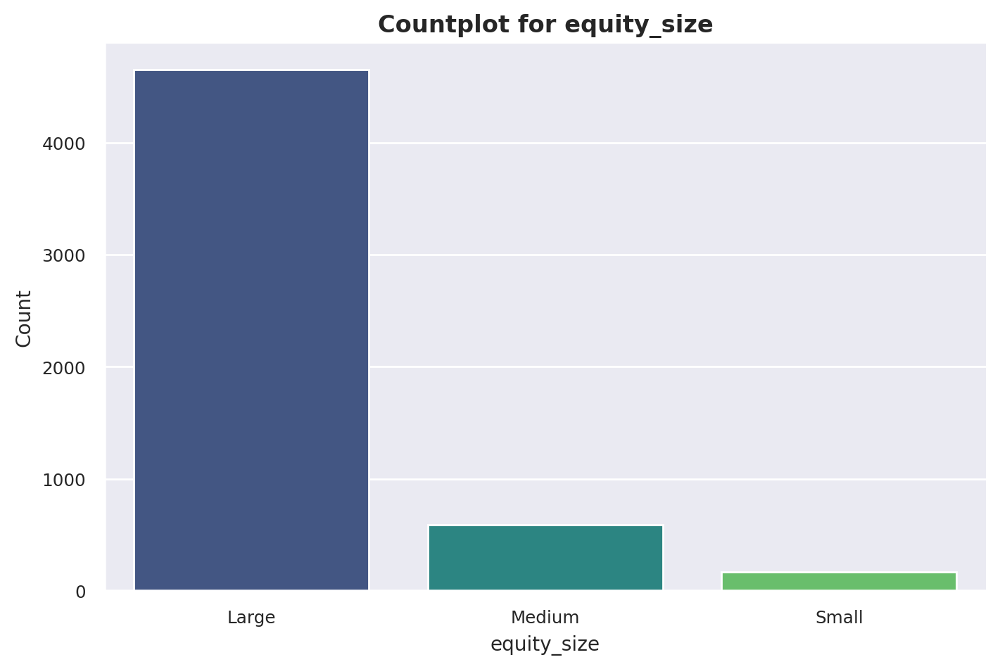

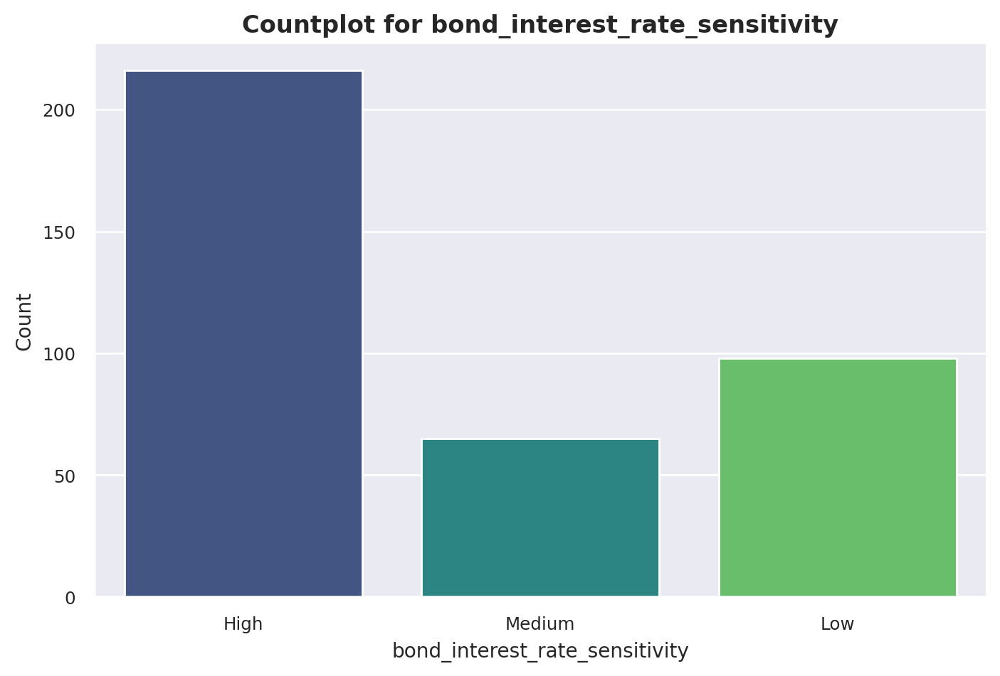

...

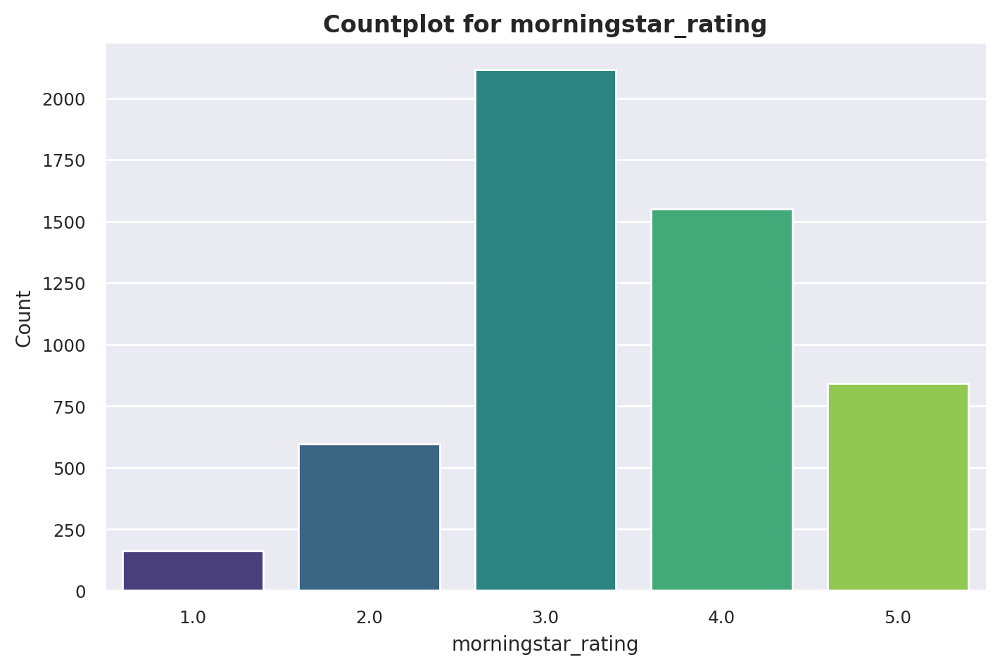

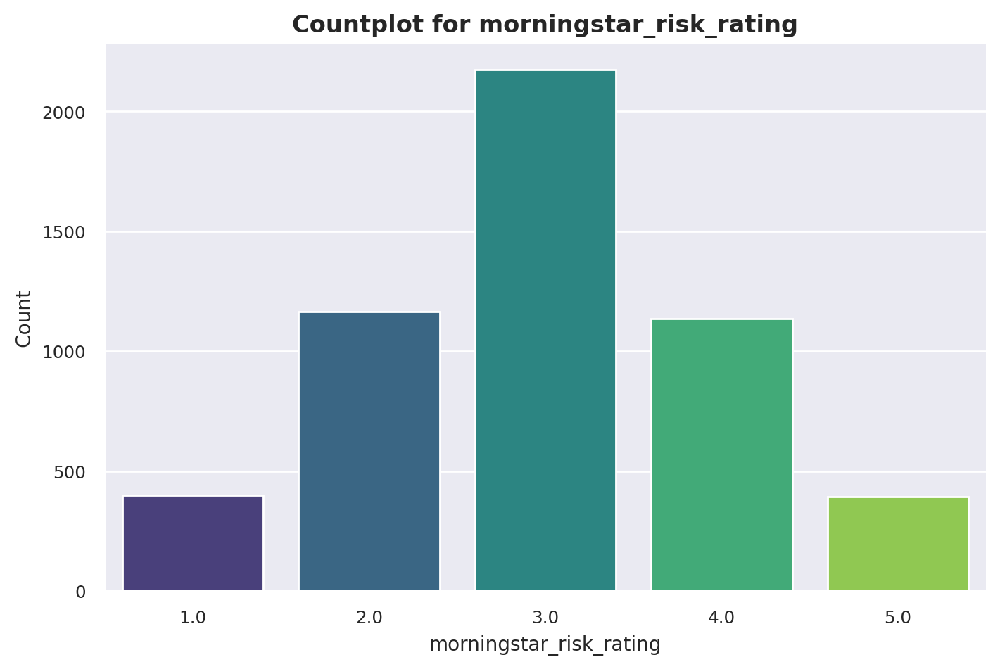

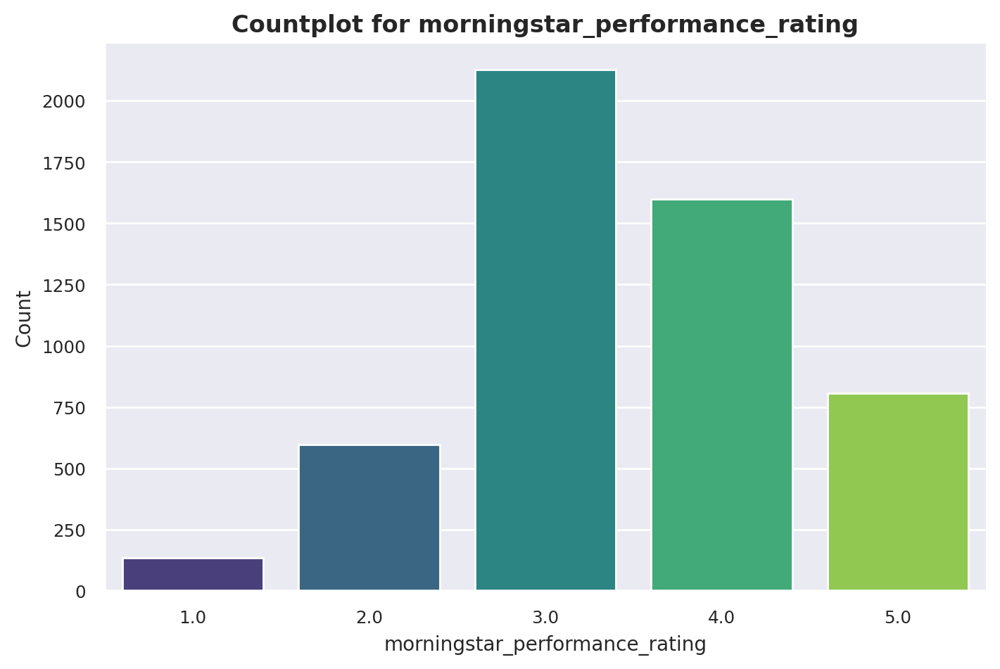

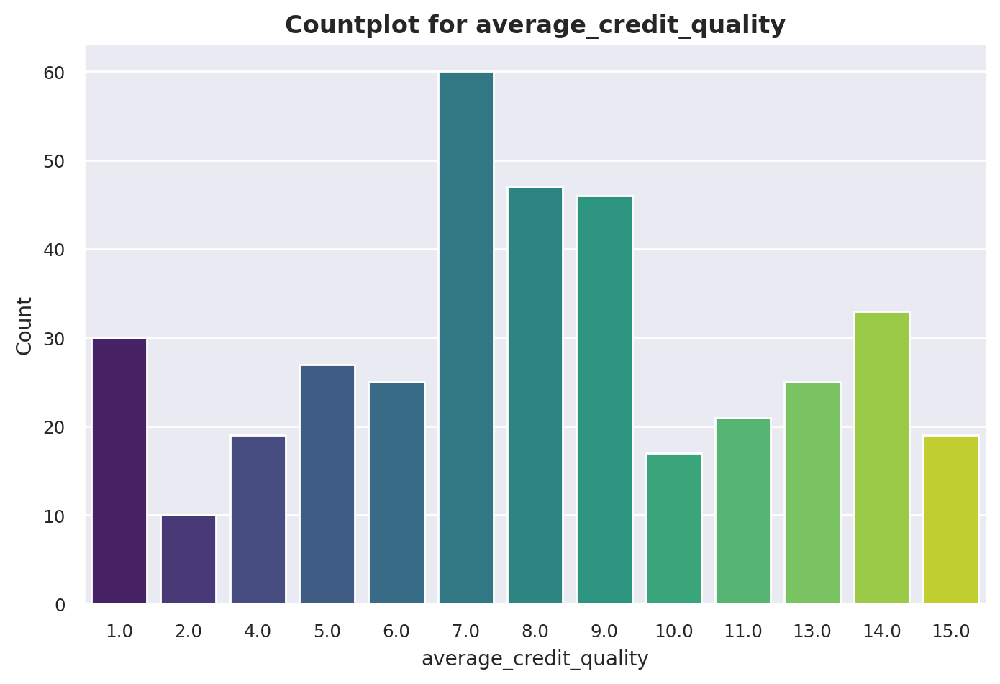

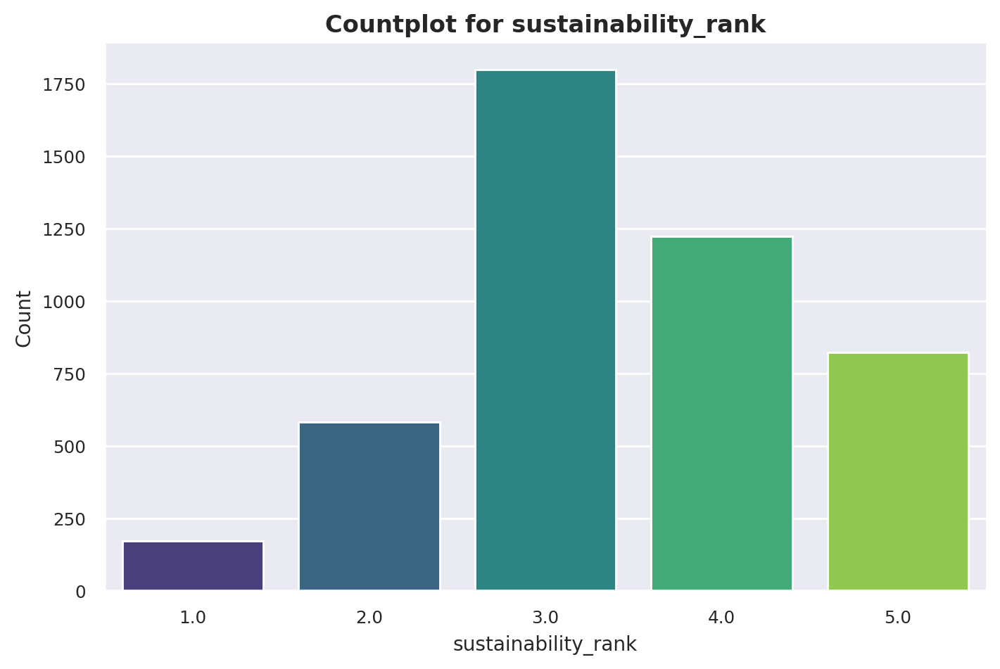

In [ ]:
# # Count(Occurence) - plot of Categorical variables - MF

# for col in mf_small_cat.columns:
#     plt.figure(figsize=(8, 5), dpi=101, edgecolor="black")
#     plt.subplots_adjust(hspace=0.7, wspace=0.6)
#     sns.countplot(x=col, data=mf_small_cat, orient="v", palette="Set2", saturation=0.85)
#     plt.show()
#

for col in mf_small_cat.columns:
    plt.figure(figsize=(8, 5), dpi=101, edgecolor="black")
    plt.subplots_adjust(hspace=0.7, wspace=0.6)
    sns.countplot(x=col, data=mf_small_cat, orient="v", palette="viridis", saturation=0.8)
    plt.title(f"Countplot for {col}", fontsize=12, fontweight="bold")
    plt.xlabel(col, fontsize=10)
    plt.ylabel("Count", fontsize=10)
    sns.despine()
    plt.show()

**Observation:**

**Fund Ratings:**

The majority of funds are commonly classified as neutral, followed by bronze, and subsequently silver.


**Dividend Payouts:**

Dividend distributions among funds predominantly occur on an annual basis, with quarterly payouts also prevalent.


**Investment Styles:**

Within the fund landscape, a combination of value and growth-oriented funds is observed, with a notable prevalence of blend funds.



**Market Capitalization:**

Large-cap funds exhibit a clear dominance when compared to their small and medium-cap counterparts.


**Bond-Related Insights:**

Notably, there is a heightened sensitivity of funds to changes in bond interest rates.
Funds with low bond credit quality surpass those with medium quality, while high-quality funds are relatively less common.


**Currency Composition:**

The primary fund size currencies are USD, EUR, and GBP, signifying their dominance within the dataset.

** *italicized text*Abundant Category Occurrence Plot-MF**
--

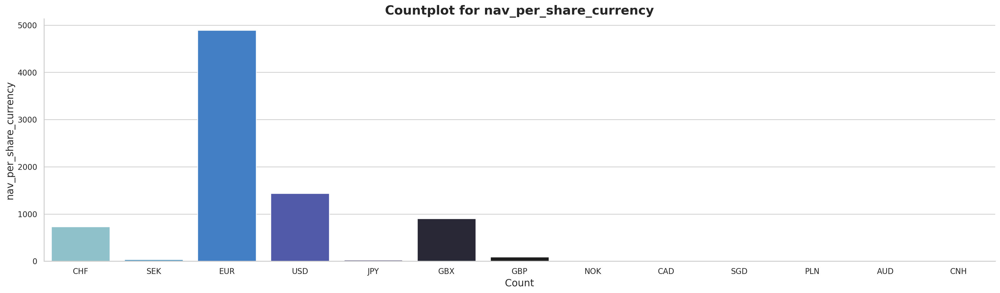

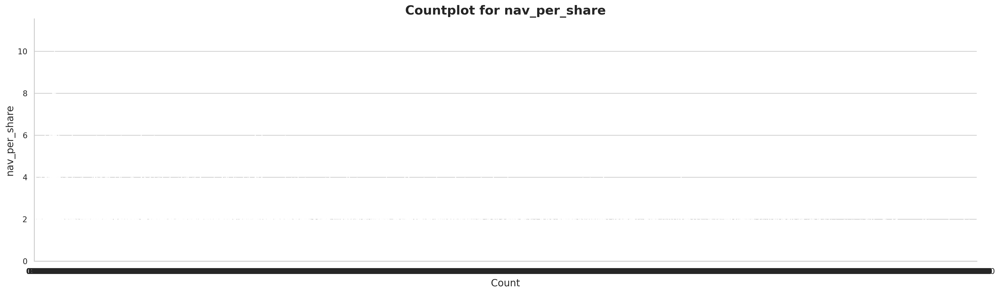

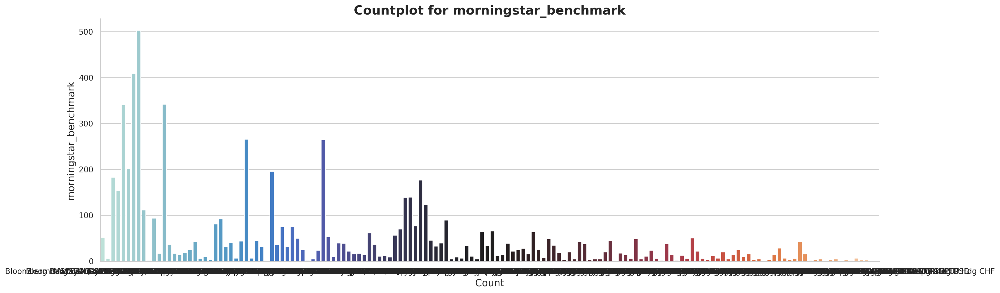

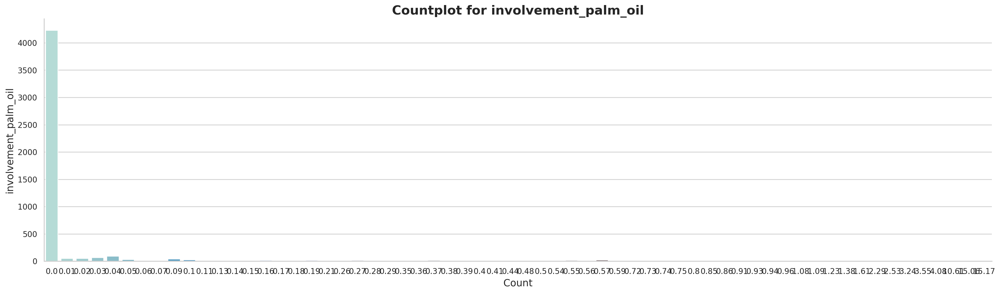

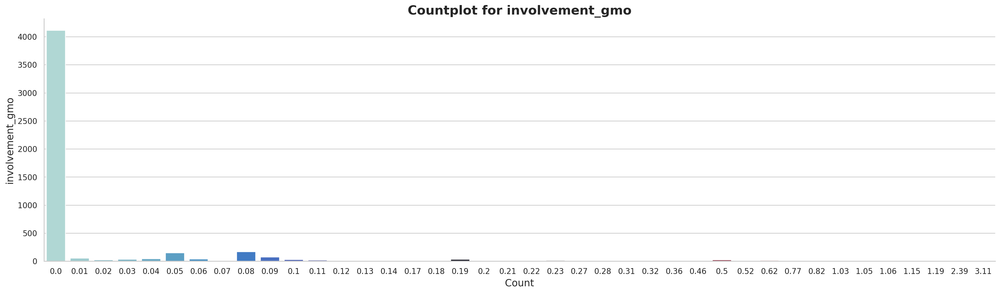

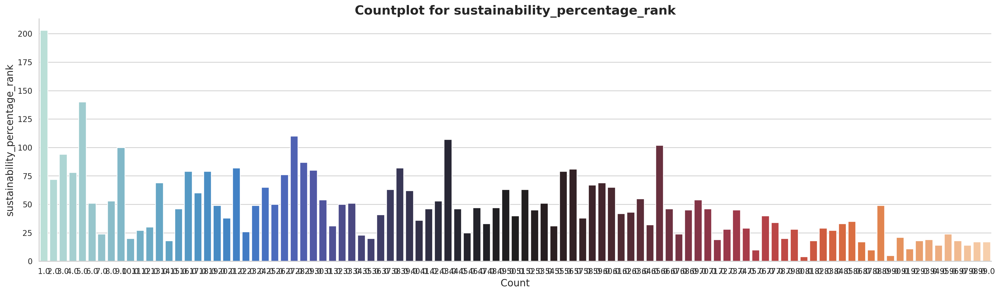

In [ ]:
# for col in (mf_big_cat.columns):
#     plt.figure(figsize = (20,6), dpi = 90, edgecolor = "b")
#     plt.subplots_adjust(hspace = 0.7, wspace = 0.6)
#     sns.countplot(x = col, data = mf_big_cat, orient = "h", palette = "icefire" , saturation = 0.85 )
# plt.show()

for col in mf_big_cat.columns:
    plt.figure(figsize=(20, 6), dpi=90, edgecolor="b")
    sns.set(style="whitegrid")
    sns.countplot(x=col, data=mf_big_cat, orient="h", palette="icefire", saturation=0.85)
    plt.title(f"Countplot for {col}", fontsize=18, fontweight="bold")
    plt.xlabel("Count", fontsize=14)
    plt.ylabel(col, fontsize=14)
    plt.yticks(rotation=0, ha='right')
    plt.tight_layout()
    sns.despine()
    plt.show()

# Variables "morningstar_benchmark", "involment_palm_oil", "involvment_gmo", "sustanability_percentage_rank" has too many claases to fit in x - axis.
# 2. There 2 ways to deal with this.
#     - Sort only top 10 or 15 most frequent class and then plot that most frequent classes whiich surely enhances the readibility quotient.
#     - Plot the classes on Y - axis.

Charts of category variables unique counts equals to and less than 5 -MF

> Indented block


---


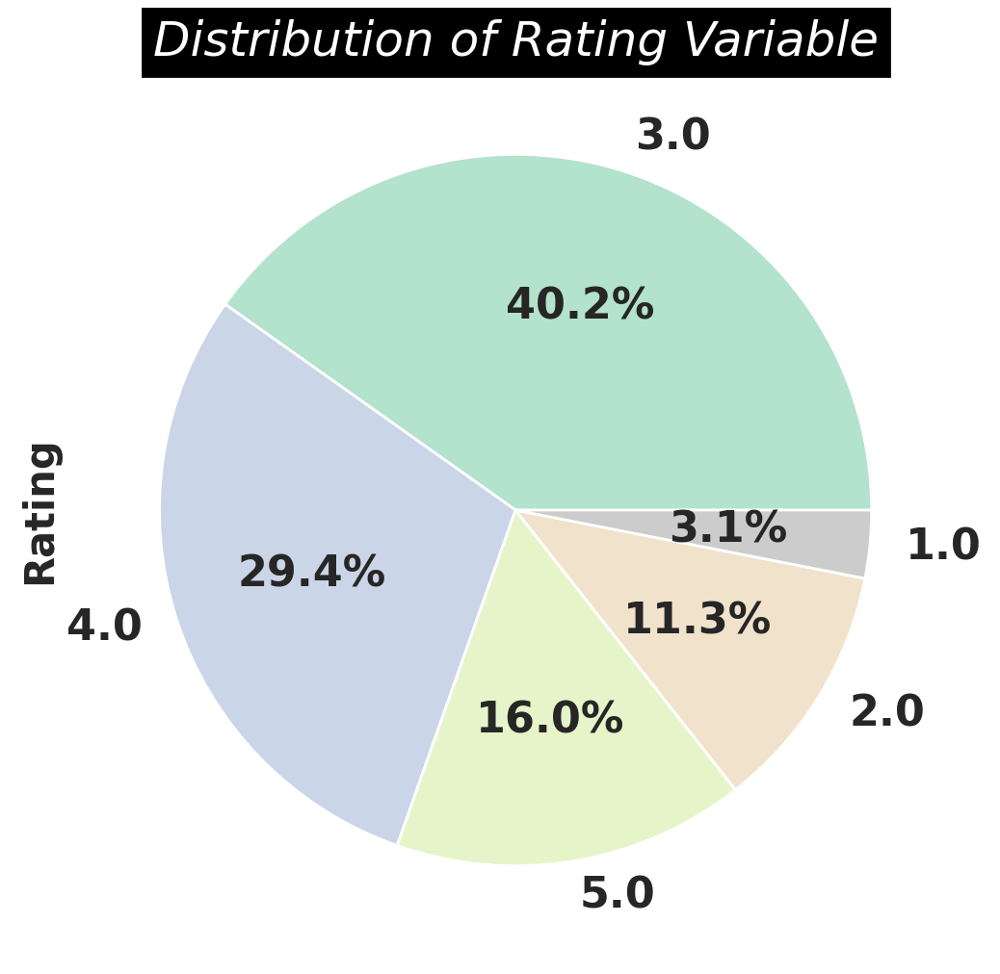

In [ ]:
fig = plt.figure(figsize = (11,6))
plt.title("Distribution of Rating Variable", size = 18,  fontweight = 10, pad = '2.0', loc = "center",
         fontstyle = 'italic', color = 'w',backgroundcolor = 'black')
df_mf["morningstar_rating"].value_counts().plot(kind = "pie", autopct = "%1.1f%%", cmap = 'Pastel2',
                                   textprops={'fontsize': 16, 'weight' : "bold"})
plt.ylabel('Rating', fontsize = 15, fontweight = "bold");

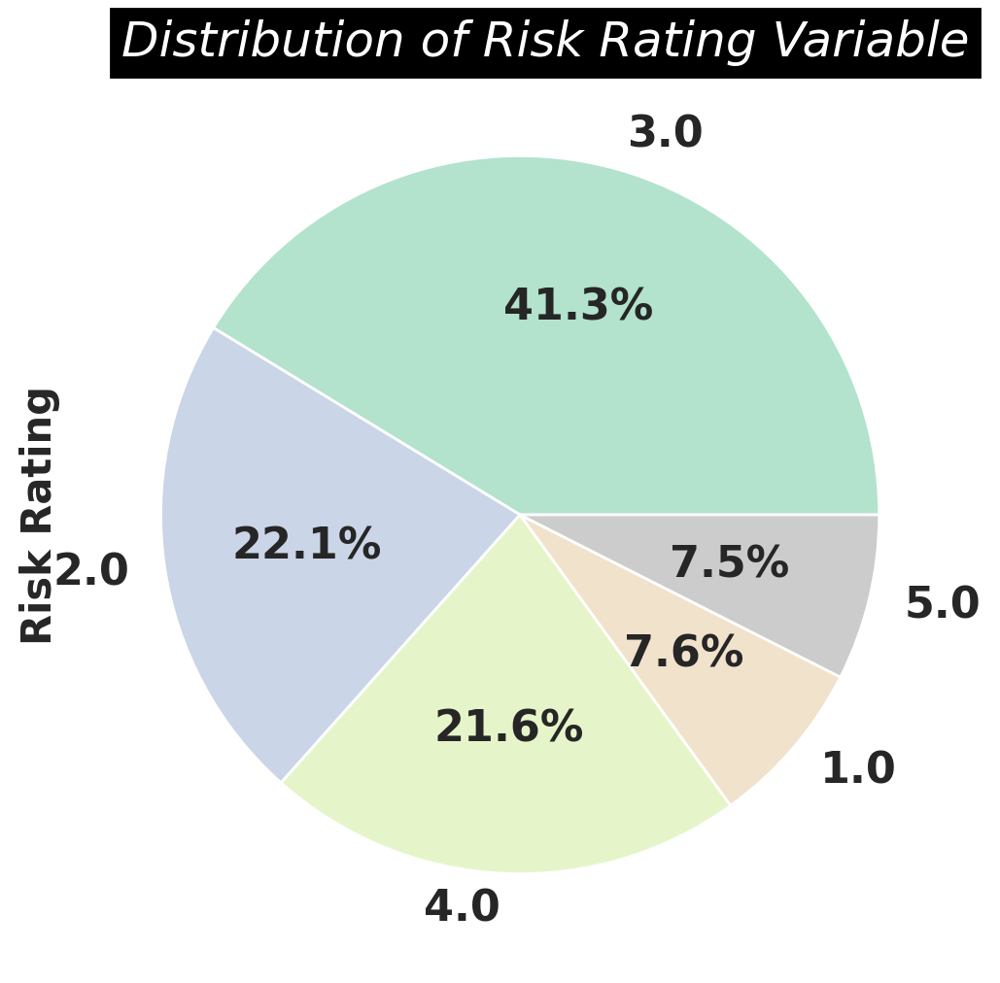

In [ ]:
fig = plt.figure(figsize = (11,6))
plt.title("Distribution of Risk Rating Variable", size = 18,  fontweight = 10, pad = '2.0', loc = "right",
         fontstyle = 'italic', color = 'w',backgroundcolor = 'black')
df_mf["morningstar_risk_rating"].value_counts().plot(kind = "pie", autopct = "%1.1f%%", cmap = 'Pastel2',
                                   textprops={'fontsize': 16, 'weight' : "bold"})
plt.ylabel('Risk Rating', fontsize = 15, fontweight = "bold");

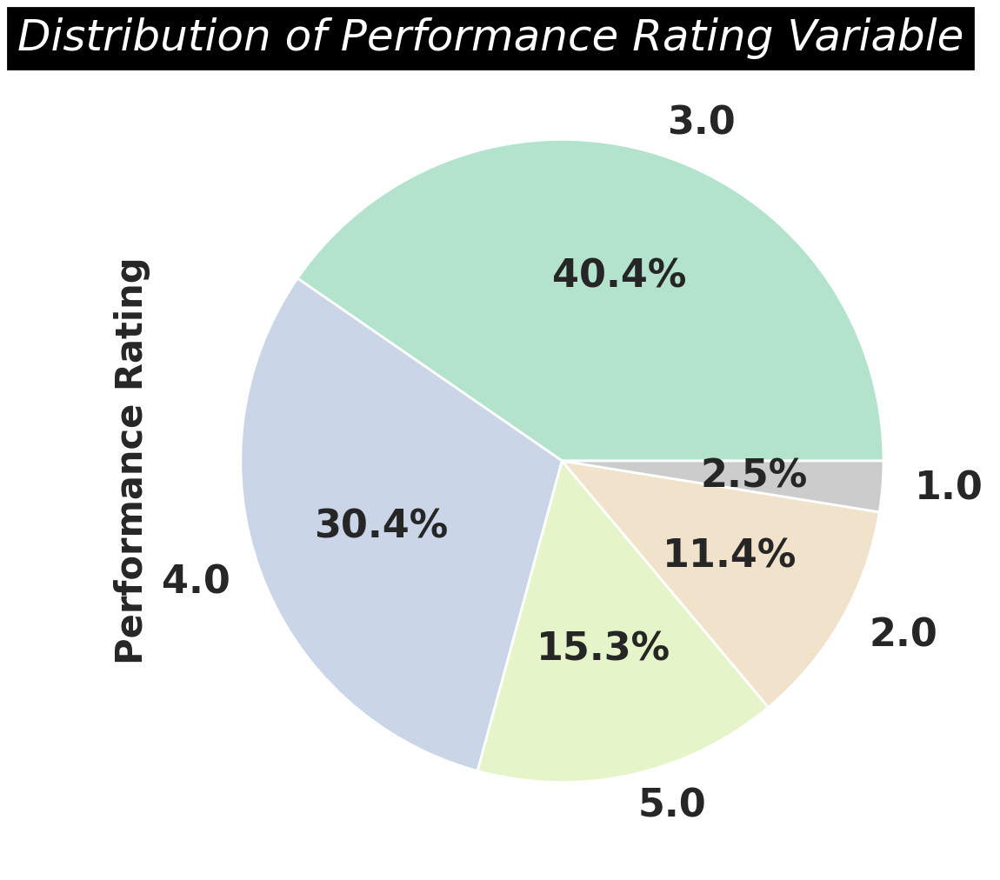

In [ ]:
fig = plt.figure(figsize = (11,6))
plt.title("Distribution of Performance Rating Variable", size = 18,  fontweight = 10, pad = '2.0', loc = "right",
         fontstyle = 'italic', color = 'w',backgroundcolor = 'black')
df_mf["morningstar_performance_rating"].value_counts().plot(kind = "pie", autopct = "%1.1f%%", cmap = 'Pastel2',
                                   textprops={'fontsize': 16, 'weight' : "bold"})
plt.ylabel('Performance Rating', fontsize = 15, fontweight = "bold");

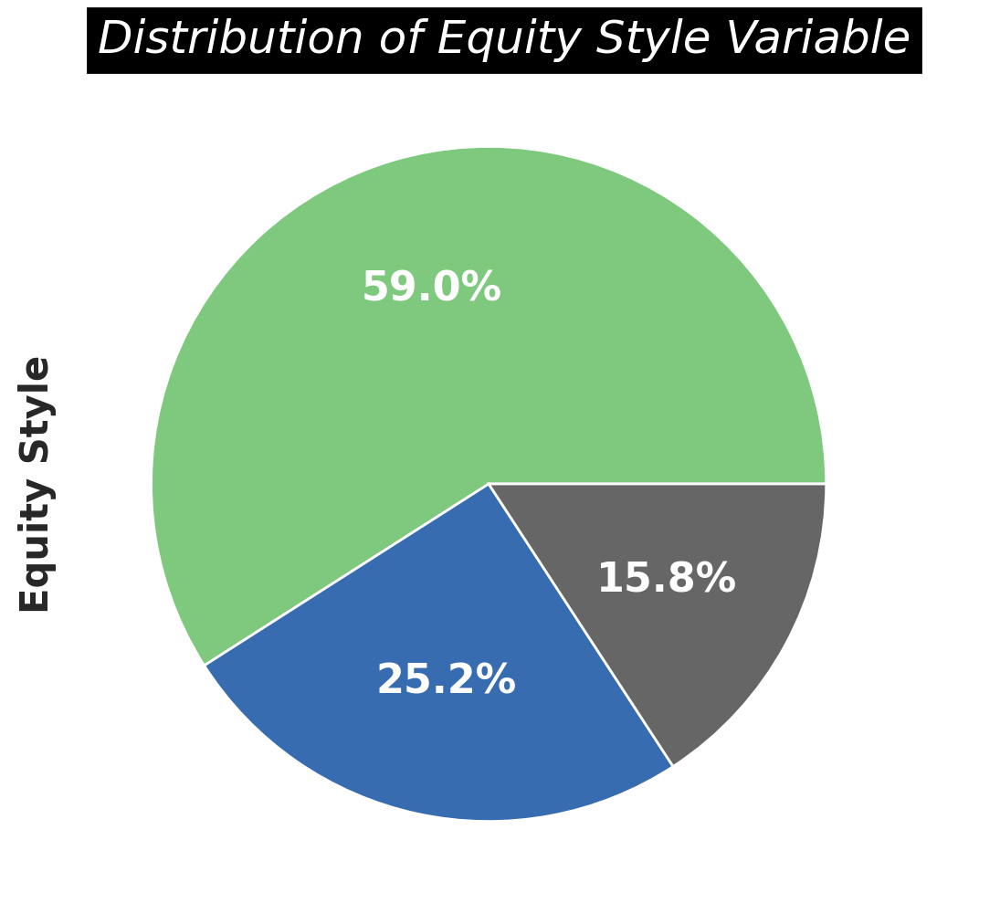

In [ ]:
fig = plt.figure(figsize = (11,6))
plt.title("Distribution of Equity Style Variable", size = 18,  fontweight = 10, pad = '2.0', loc = "right",
         fontstyle = 'italic', color = 'w',backgroundcolor = 'black')
df_mf["equity_style"].value_counts().plot(kind = "pie", autopct = "%1.1f%%", cmap = 'Accent',
                                   textprops={'fontsize': 16, 'color': "w", 'weight' : "bold"})
plt.ylabel('Equity Style', fontsize = 15, fontweight = "bold");

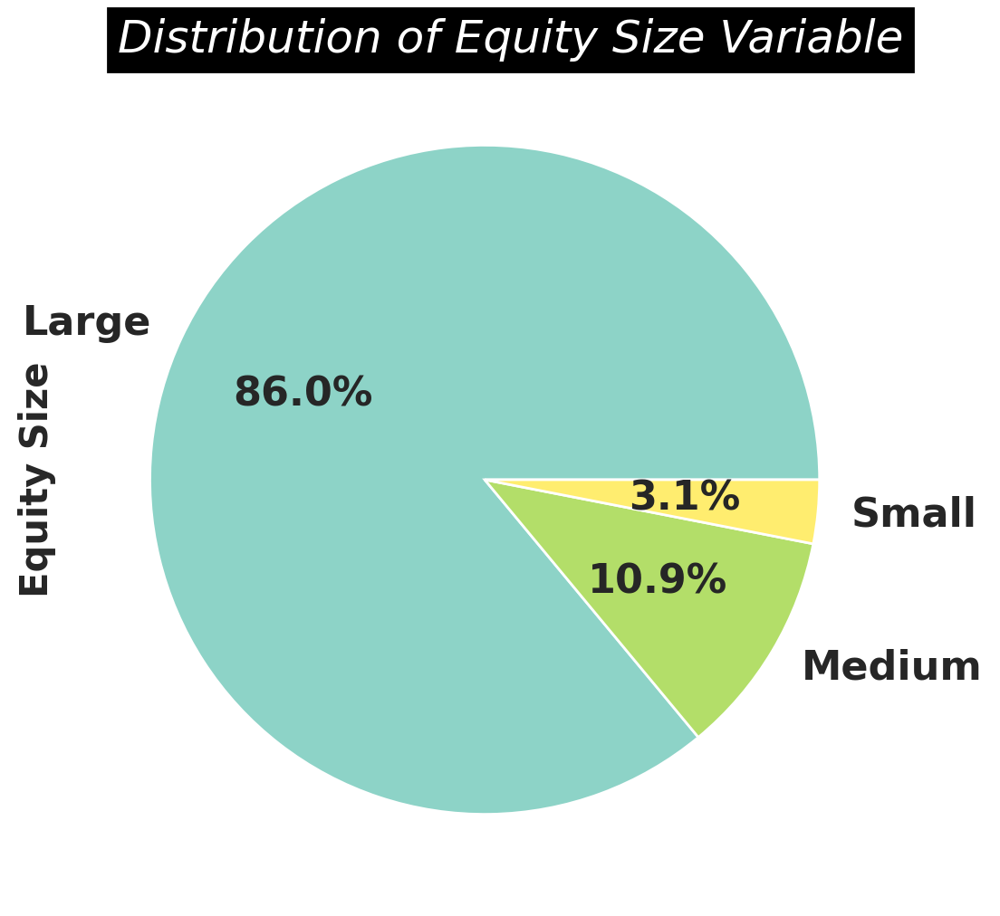

In [ ]:
fig = plt.figure(figsize = (11,6))
plt.title("Distribution of Equity Size Variable", size = 18,  fontweight = 10, pad = '2.0', loc = "right",
         fontstyle = 'italic', color = 'w',backgroundcolor = 'black')
df_mf["equity_size"].value_counts().plot(kind = "pie", autopct = "%1.1f%%", cmap = 'Set3',
                                   textprops={'fontsize': 16, 'weight' : "bold"})
plt.ylabel('Equity Size', fontsize = 15, fontweight = "bold");

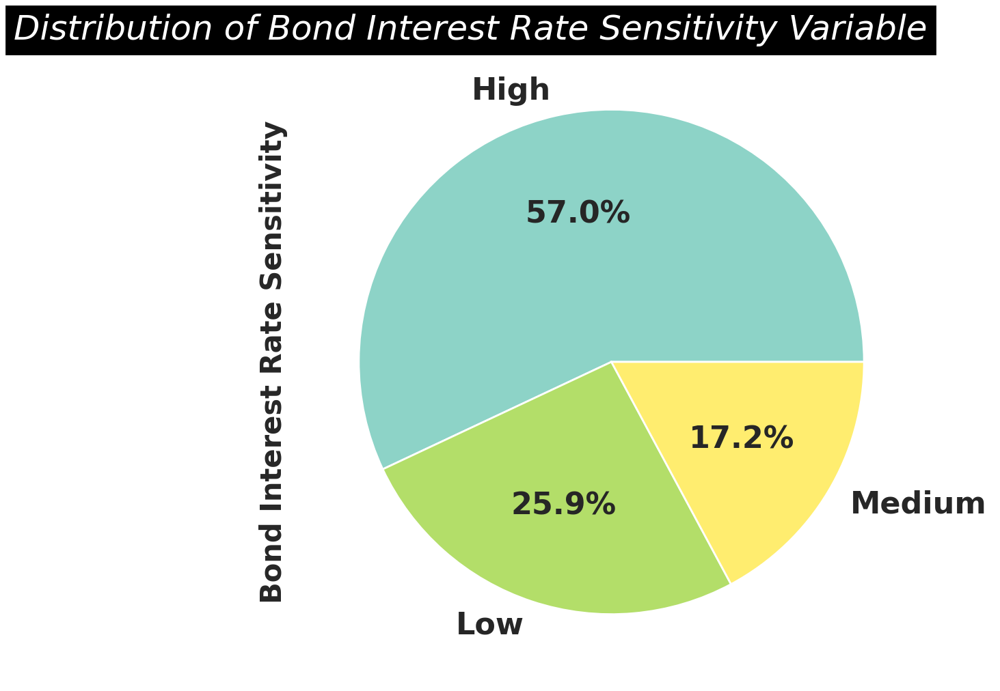

In [ ]:
fig = plt.figure(figsize = (11,6))
plt.title("Distribution of Bond Interest Rate Sensitivity Variable", size = 18,  fontweight = 10, pad = '2.0',
          loc = "right", fontstyle = 'italic', color = 'w',backgroundcolor = 'black')
df_mf["bond_interest_rate_sensitivity"].value_counts().plot(kind = "pie", autopct = "%1.1f%%", cmap = 'Set3',
                                   textprops={'fontsize': 16, 'weight' : "bold"})
plt.ylabel('Bond Interest Rate Sensitivity', fontsize = 15, fontweight = "bold");

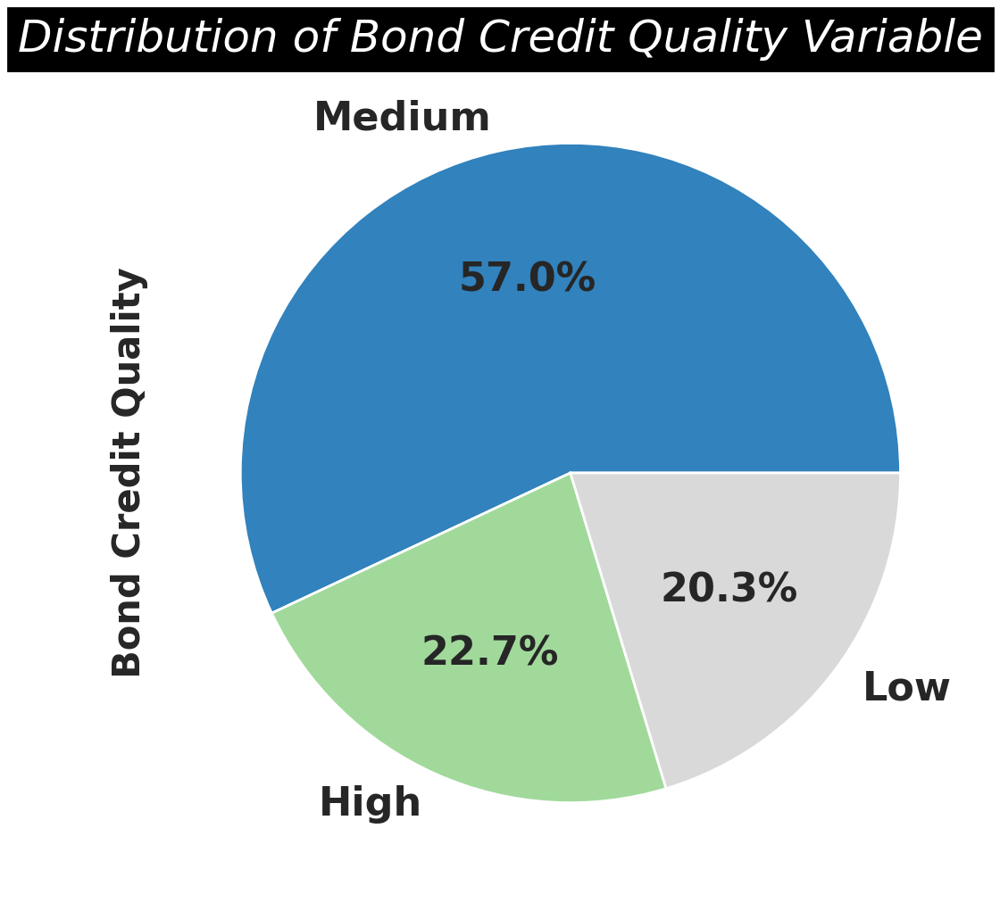

In [ ]:
fig = plt.figure(figsize = (11,6))
plt.title("Distribution of Bond Credit Quality Variable", size = 18,  fontweight = 10, pad = '2.0', loc = "right",
         fontstyle = 'italic', color = 'w',backgroundcolor = 'black')
df_mf["bond_credit_quality"].value_counts().plot(kind = "pie", autopct = "%1.1f%%", cmap = 'tab20c',
                                   textprops={'fontsize': 16, 'weight' : "bold"})
plt.ylabel('Bond Credit Quality', fontsize = 15, fontweight = "bold");

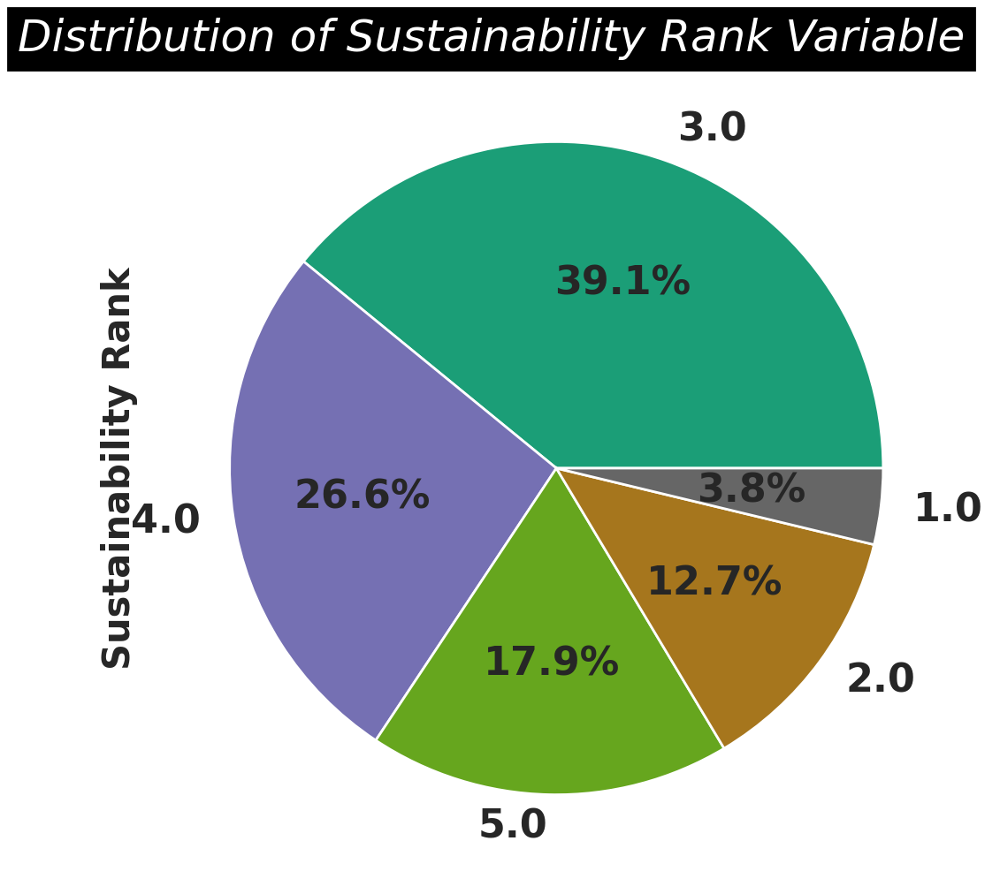

In [ ]:
fig = plt.figure(figsize = (11,6))
plt.title("Distribution of Sustainability Rank Variable", size = 18,  fontweight = 10, pad = '2.0', loc = "right",
         fontstyle = 'italic', color = 'w',backgroundcolor = 'black')
df_mf["sustainability_rank"].value_counts().plot(kind = "pie", autopct = "%1.1f%%", cmap = 'Dark2',
                                   textprops={'fontsize': 16, 'weight' : "bold"})
plt.ylabel('Sustainability Rank', fontsize = 15, fontweight = "bold");

**Numerical Features**
---
Scatter plots are a valuable visualization tool, particularly for exploring relationships between two numerical variables.

The overall pattern of a scatterplot can be described by the direction, form, and strength of the relationship. An important kind of departure is an outlier, an individual value that falls outside the overall pattern of the relationship. Scatter plot is the visual reprsentation of Correlation matrix.


In [ ]:
corr_matrix = df_mf.corr(method = "pearson").round(2)
corr_matrix.style.background_gradient(cmap = 'YlGnBu')

/usr/local/lib/python3.10/dist-packages/pandas/io/formats/style.py:3931: RuntimeWarning:

All-NaN slice encountered

/usr/local/lib/python3.10/dist-packages/pandas/io/formats/style.py:3932: RuntimeWarning:

All-NaN slice encountered



,morningstar_rating,morningstar_risk_rating,morningstar_performance_rating,nav_per_share,class_size,fund_size,fund_return_ytd,fund_return_2018,fund_return_2017,fund_return_2016,fund_return_2015,fund_return_2014,fund_return_2013,fund_return_2012,fund_return_2011,fund_return_2010,trailing_return_3years,trailing_return_5years,trailing_return_10years,trailing_return_since_inception,equity_style_score,equity_size_score,price_prospective_earnings,price_book,price_sales,price_cash_flow,dividend_yield_factor,long_term_projected_earnings_growth,historical_earnings_growth,sales_growth,cash_flow_growth,book_value_growth


In [ ]:
corr_matrix_df = corr_matrix.unstack()
corr_matrix = corr_matrix[abs(corr_matrix) >= 0.8]

# print(corr_matrix)

corr_matrix.style.background_gradient(cmap = 'vlag')

In [ ]:
# Correlation of Variables (Cross - checking of above Correlation matrix)

print(df_mf['morningstar_rating'].corr(df_mf['morningstar_performance_rating'])) # ---> 0.93
print(df_mf['roa'].corr(df_mf['roe']))  # ---> 0.91
print(df_mf['roa'].corr(df_mf['roic'])) # ---> 0.96
print(df_mf['roe'].corr(df_mf['roic'])) # ---> 0.88
print(df_mf['asset_stock'].corr(df_mf['asset_bond'])) # ---> -0.83
print(df_mf['ongoing_cost'].corr(df_mf['management_fees'])) # ---> 0.88
print(df_mf['environmental_score'].corr(df_mf['social_score'])) # ---> 0.81
print(df_mf['environmental_score'].corr(df_mf['governance_score'])) # ---> 0.83
print(df_mf['sustainability_rank'].corr(df_mf['sustainability_percentage_rank'])) # ---> -0.91
print(df_mf['involvement_abortive_contraceptive'].corr(df_mf['involvement_animal_testing'])) # ---> 0.82
print(df_mf['fund_return_2018'].corr(df_mf['fund_return_2018'])) # ---> 0.88
print(df_mf['fund_return_2017'].corr(df_mf['fund_return_2017'])) # ---> 0.81

0.9489740019681054
0.8831915504119887
0.882981214283288
0.848143108792415
-0.7107692971610923
0.5307790926611523
0.8964087784965101
0.7753228360602631
-0.9554979528205678
0.7160949932367185
1.0
0.9999999999999999


<Axes: title={'center': 'MF - Correlation HeatMap with Threshold limit >= 0.80'}>

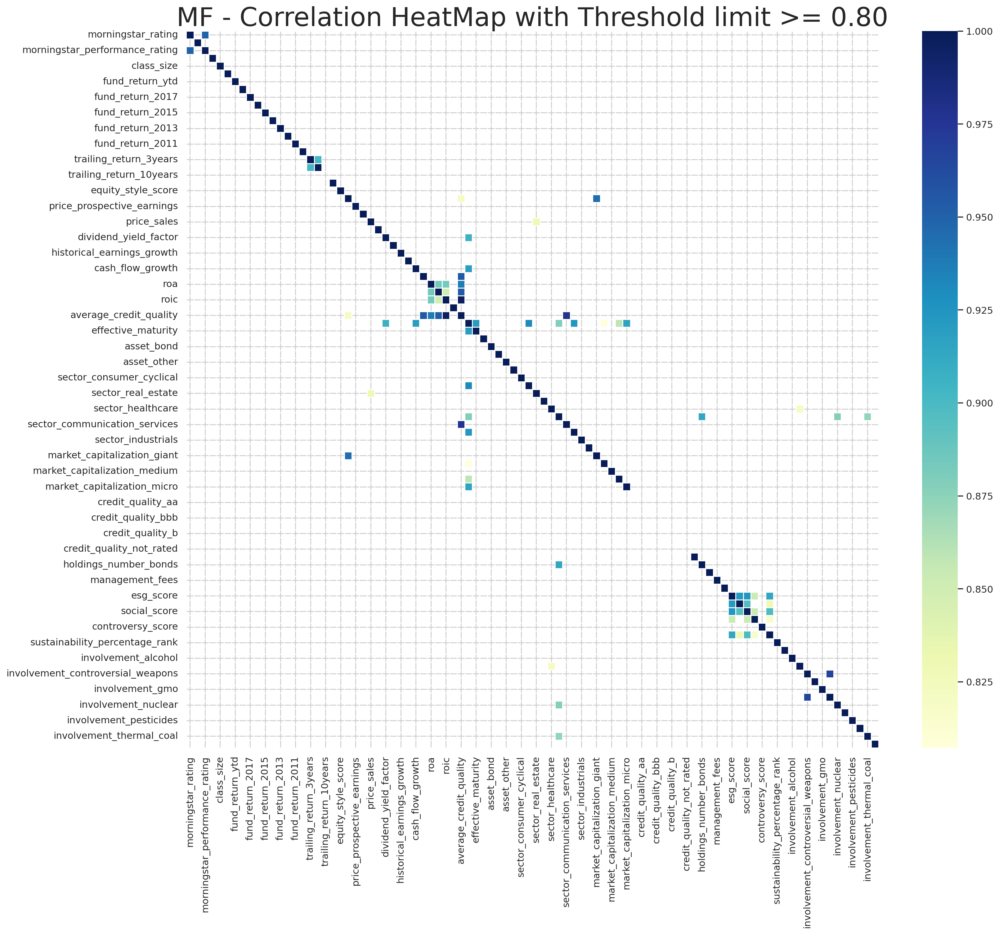

In [ ]:
plt.figure(figsize = (18,15))
plt.title("MF - Correlation HeatMap with Threshold limit >= 0.80", fontsize = 30)
correlation = df_mf_num.corr()
sns.heatmap(correlation, mask = correlation < 0.8, linewidth = 1.0, cmap = "YlGnBu", annot = False)

<Axes: title={'center': 'MF - Correlation HeatMap with Threshold limit >= 0.80'}>

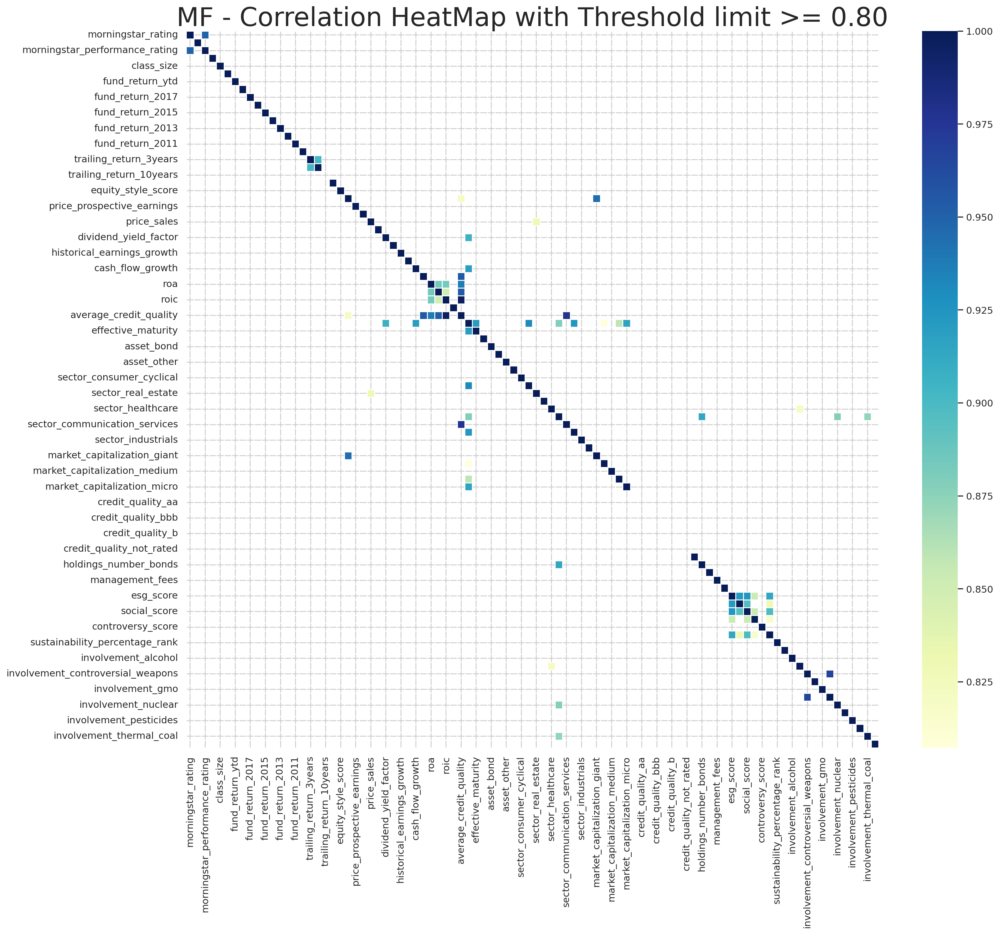

In [ ]:
plt.figure(figsize = (18,15))
plt.title("MF - Correlation HeatMap with Threshold limit >= 0.80", fontsize = 30)
correlation = df_mf_num.corr()
sns.heatmap(correlation, mask = correlation < 0.8, linewidth = 1.0, cmap = "YlGnBu", annot = False)

Missing values


*   df.isnull().sum()


*   df.isna().sum()


*   df.notnull().sum()


*   df.isnull().sum().sum()


*   df.isnull().mean() * 100


*   percent_missing = df.isnull().sum() * 100 / len(df)


*   percent_missing = df.isnull().sum().sort_values(ascending = False) * 100 / len(df)


*   df.isnull().sum().sort_values(ascending = False)


*   df.isna().sum().sort_values(ascending = False)


*   Missing Value Visualization - Bar Chart

*   Missing Value Visualization - Dendogram





In [ ]:
df_mf[df_mf.columns[~df_mf.isnull().any()]].iloc[0:5, :].info()  # ---> Utilized the functionality of Negation.

# This are features having no missing values.
# As observed these features are very less


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5 entries, 0 to 4
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   ticker                  5 non-null      object 
 1   isin                    5 non-null      object 
 2   fund_name               5 non-null      object 
 3   morningstar_category    5 non-null      object 
 4   nav_per_share_currency  5 non-null      object 
 5   nav_per_share           5 non-null      float64
 6   class_size_currency     5 non-null      object 
 7   class_size              5 non-null      int64  
 8   fund_size_currency      5 non-null      object 
 9   fund_size               5 non-null      int64  
 10  asset_stock             5 non-null      float64
 11  asset_bond              5 non-null      float64
 12  asset_cash              5 non-null      float64
 13  asset_other             5 non-null      float64
 14  top5_holdings           5 non-null      object

In [ ]:
# Create a DataFrame of features having Missing Values - MF
# So we drop features with all values.
df_mf_missing = df_mf.loc[:, df_mf.columns.drop(["ticker", "isin", "fund_name",
                                                 "morningstar_category", "asset_stock", "asset_bond",
                                                 "asset_cash", "asset_other",
                                                 "nav_per_share_currency",
                                                 "nav_per_share", ])]

In [ ]:
# Defining percent_missing_mf
percent_missing_mf = ((df_mf_missing.isnull().sum() / len (df_mf_missing)) * 100).sort_values(ascending = False)

print("\nMost values missing")
display(percent_missing_mf.nlargest(10))


print("\nleast values missing")
display(percent_missing_mf.nsmallest(10))


print("\n50 to 75 percentile values missing")
display(percent_missing_mf[50:75])


Most values missing


trailing_return_10years    99.98772
credit_quality_bbb         99.95088
credit_quality_bb          99.95088
credit_quality_b           99.95088
credit_quality_below_b     99.95088
credit_quality_not_rated   99.95088
credit_quality_a           99.95088
credit_quality_aa          99.95088
credit_quality_aaa         99.95088
modified_duration          96.25445
dtype: float64


least values missing


fund_size             0.00000
fund_size_currency    0.00000
class_size            0.00000
class_size_currency   0.00000
top5_holdings         0.00000
investment_strategy   1.49822
management_fees       3.63502
ongoing_cost          5.57534
fund_return_ytd       8.22793
fund_benchmark        8.78055
dtype: float64


50 to 75 percentile values missing


sustainability_score                 40.51332
environmental_score                  40.51332
esg_score                            40.51332
controversy_score                    40.31684
roic                                 39.37124
involvement_military_contracting     38.06951
involvement_thermal_coal             38.06951
involvement_small_arms               38.06951
involvement_pesticides               38.06951
involvement_palm_oil                 38.06951
involvement_nuclear                  38.06951
involvement_animal_testing           38.06951
involvement_gmo                      38.06951
involvement_gambling                 38.06951
involvement_controversial_weapons    38.06951
involvement_alcohol                  38.06951
involvement_abortive_contraceptive   38.06951
involvement_tobacco                  38.06951
cash_flow_growth                     35.52745
morningstar_rating                   35.35552
morningstar_risk_rating              35.35552
morningstar_performance_rating    

In [ ]:
# Cross- Checking of DataFrame  - MF

display(df_mf.shape,
        df_mf_missing.shape)

(8143, 111)

(8143, 101)

In [ ]:
# Least frequent value
print("\nLeast Frequent Value")
display(percent_missing_mf.value_counts().nsmallest(5))

# Least frequent value
print("\nMost Frequent Value")
display(percent_missing_mf.value_counts().nlargest(5))




Least Frequent Value


35.52745    1
42.20803    1
41.66769    1
41.60629    1
41.52032    1
dtype: int64


Most Frequent Value


38.06951    13
33.61169     9
99.95088     8
86.73707     5
40.51332     5
dtype: int64

In [ ]:
# Assuming 'percent_missing_mf' is a pandas Series
percent_missing_mf = ((df_mf_missing.isnull().sum() / len(df_mf_missing)) * 100).sort_values(ascending=False)

# Create a DataFrame with the desired information
table_data = {
    '> 90%': [percent_missing_mf[percent_missing_mf > 90].count()],
    '> 85%': [percent_missing_mf[percent_missing_mf > 85].count()],
    '> 80%': [percent_missing_mf[percent_missing_mf > 80].count()],
    '> 75%': [percent_missing_mf[percent_missing_mf > 75].count()],
    '> 70%': [percent_missing_mf[percent_missing_mf > 70].count()],
    '> 65%': [percent_missing_mf[percent_missing_mf > 65].count()],
    '> 60%': [percent_missing_mf[percent_missing_mf > 60].count()],
    '> 55%': [percent_missing_mf[percent_missing_mf > 55].count()],
    '> 50%': [percent_missing_mf[percent_missing_mf > 50].count()],
    '> 45%': [percent_missing_mf[percent_missing_mf > 45].count()],
    '> 40%': [percent_missing_mf[percent_missing_mf > 40].count()],
    '> 35%': [percent_missing_mf[percent_missing_mf > 35].count()],
    '> 30%': [percent_missing_mf[percent_missing_mf > 30].count()],
    '> 25%': [percent_missing_mf[percent_missing_mf > 25].count()],
    '> 20%': [percent_missing_mf[percent_missing_mf > 20].count()],
    '> 15%': [percent_missing_mf[percent_missing_mf > 15].count()],
    '> 10%': [percent_missing_mf[percent_missing_mf > 10].count()],
    '> 5%': [percent_missing_mf[percent_missing_mf > 5].count()],
    '> 3%': [percent_missing_mf[percent_missing_mf > 3].count()],
    '> 2%': [percent_missing_mf[percent_missing_mf > 2].count()],
    '> 1%': [percent_missing_mf[percent_missing_mf > 1].count()],
    '< 1%': [percent_missing_mf[percent_missing_mf < 1].count()]
}

# Create a DataFrame
table_df = pd.DataFrame(table_data, index=['Count'])

# Display the table
print(table_df)

'''High Missing Values:

15 columns have over 90% missing data, indicating substantial gaps.
Incremental Trend:

The count of columns with missing values rises consistently as the threshold decreases.
Data Integrity Concerns:

A notable portion of the dataset (38 columns) has over 45% missing values, raising questions about data quality.
Critical Threshold:

5 columns have less than 1% missing values, suggesting a small but relatively complete subset.
Decision Point:

Careful consideration is needed for imputation or removal of columns with high missing values.
Investigation Needed:

Further exploration is warranted for columns with lower percentages to understand missing data patterns.'''


       > 90%  > 85%  > 80%  > 75%  > 70%  > 65%  > 60%  > 55%  > 50%  > 45%  \
Count     15     22     22     24     27     28     30     31     33     38   

       > 40%  > 35%  > 30%  > 25%  > 20%  > 15%  > 10%  > 5%  > 3%  > 2%  \
Count     54     72     88     88     88     89     91    94    95    95   

       > 1%  < 1%  
Count    96     5  


In [ ]:
# Total values accross DataFrame
display(df_mf.isnull().sum().sum())
display(df_mf.isna().sum().sum())
display(df_mf.notnull().sum().sum())
display(df_mf.notna().sum().sum())

407944

407944

495929

495929

In [ ]:
# Total values accoss df missing values.
display(df_mf_missing.isnull().sum().sum()) # ---> 2191765
display(df_mf_missing.isna().sum().sum()) #---> 2191765
display(df_mf_missing.notnull().sum().sum())  # --->  4605389
display(df_mf_missing.notna().sum().sum())# --->  4605389

407944

407944

414499

414499

In [ ]:
# 1. DataFrame ---> df_mf

display((df_mf.isnull().sum().sum() / df_mf.size * 100).round(2))  # ---> 28.83%
display((df_mf.notnull().sum().sum() / df_mf.size * 100).round(2))   # ---> 71.17%


# 2. DataFrame ---> df_mf_missing

display((df_mf_missing.isnull().sum().sum() / df_mf_missing.size * 100).round(2))  # ---> 32.25%
display((df_mf_missing.notnull().sum().sum() / df_mf_missing.size * 100).round(2))   # ---> 67.75%


45.13

54.87

49.6

50.4

<Axes: >

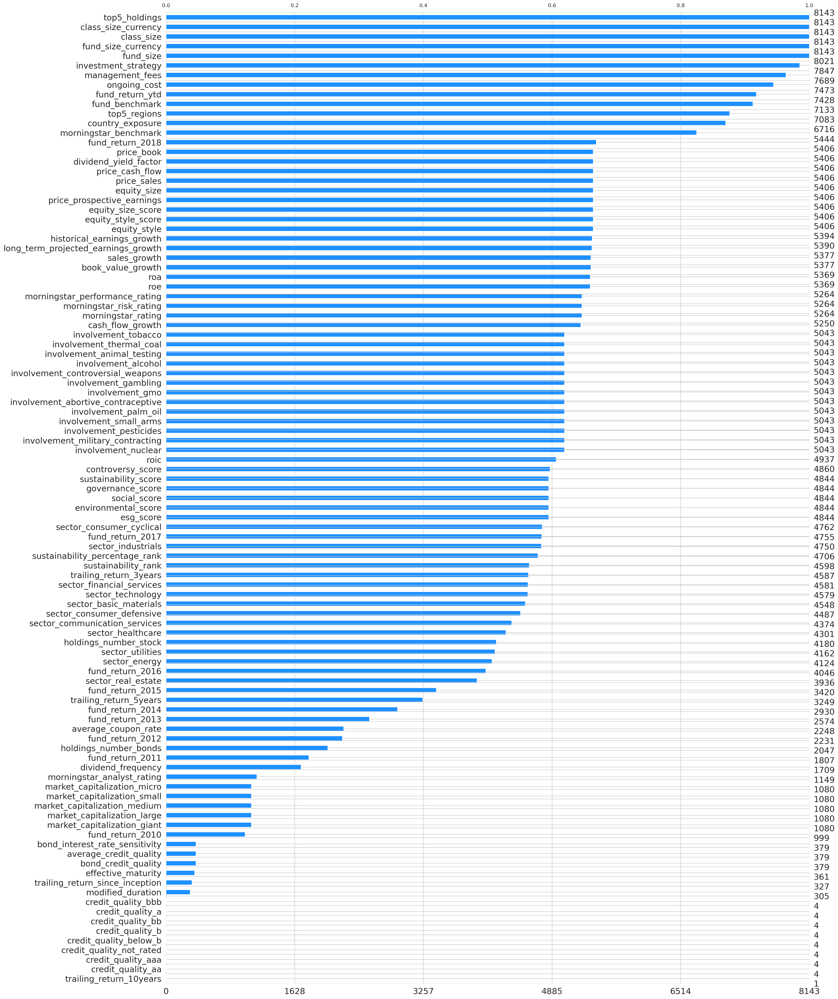

In [ ]:
# Now, Visualizing the Missing values - MF
msno.bar(df_mf_missing, color = 'dodgerblue' , fontsize = 18, sort = "ascending", )

<Axes: >

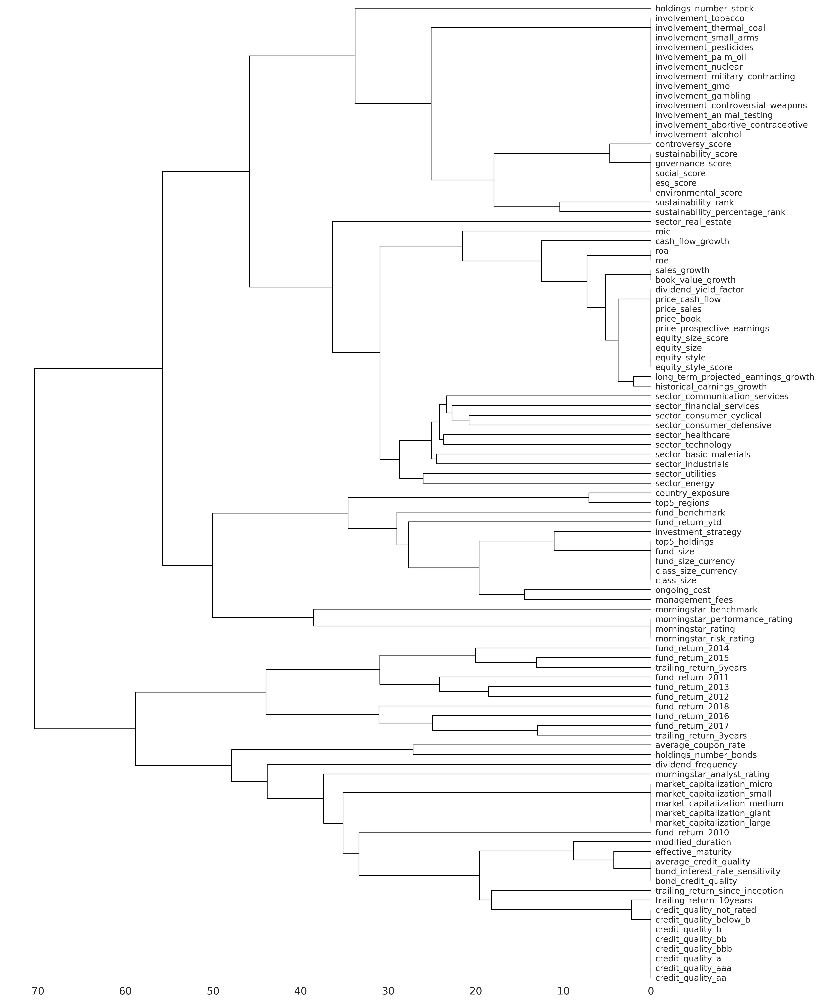

In [ ]:
msno.dendrogram(df_mf_missing, fontsize = 18, method = "average")

**Duplicate values**
--


In [ ]:
# Duplicate Values - For a DataFrame as a whole - MF

df_mf.duplicated().sum()

0

In [ ]:
(~df_mf.duplicated()).sum()  # ---> 57603

8143

In [ ]:
(~df_mf.duplicated()).sum()  # ---> 57603

8143

In [ ]:
df_mf[df_mf.duplicated('ticker')]  # ---> 0
df_mf[df_mf.duplicated('isin')] # ---> 2779
df_mf[df_mf.duplicated('fund_name')] # ---> 3596

,ticker,isin,fund_name,morningstar_category,morningstar_rating,morningstar_analyst_rating,morningstar_risk_rating,morningstar_performance_rating,nav_per_share_currency,nav_per_share,class_size_currency,class_size,fund_size_currency,fund_size,fund_return_ytd,fund_return_2018,fund_return_2017,fund_return_2016,fund_return_2015,fund_return_2014,fund_return_2013,fund_return_2012,fund_return_2011,fund_return_2010,investment_strategy,trailing_return_3years,trailing_return_5years,trailing_return_10years,trailing_return_since_inception,dividend_frequency,fund_benchmark,morningstar_benchmark,equity_style,equity_style_score,equity_size,equity_size_score,price_prospective_earnings,price_book,price_sales,price_cash_flow,dividend_yield_factor,long_term_projected_earnings_growth,historical_earnings_growth,sales_growth,cash_flow_growth,book_value_growth,roa,roe,roic,bond_interest_rate_sensitivity,bond_credit_quality,average_coupon_rate,average_credit_quality,modified_duration,effective_maturity,asset_stock,asset_bond,asset_cash,asset_other,country_exposure,top5_regions,sector_basic_materials,sector_consumer_cyclical,sector_financial_services,sector_real_estate,sector_consumer_defensive,sector_healthcare,sector_utilities,sector_communication_services,sector_energy,sector_industrials,sector_technology,market_capitalization_giant,market_capitalization_large,market_capitalization_medium,market_capitalization_small,market_capitalization_micro,credit_quality_aaa,credit_quality_aa,credit_quality_a,credit_quality_bbb,credit_quality_bb,credit_quality_b,credit_quality_below_b,credit_quality_not_rated,holdings_number_stock,holdings_number_bonds,top5_holdings,ongoing_cost,management_fees,sustainability_rank,esg_score,environmental_score,social_score,governance_score,controversy_score,sustainability_score,sustainability_percentage_rank,involvement_abortive_contraceptive,involvement_alcohol,involvement_animal_testing,involvement_controversial_weapons,involvement_gambling,involvement_gmo,involvement_military_contracting,involvement_nuclear,involvement_palm_oil,involvement_pesticides,involvement_small_arms,involvement_thermal_coal,involvement_tobacco
35,0P00001FJ0,IE00B02KXH56,iShares MSCI Japan UCITS ETF USD (Dist),Japan Large-Cap Equity,3.00000,Neutral,2.00000,3.00000,EUR,13.08000,USD,1462430000,USD,1462430000,13.48000,-9.11000,13.17000,22.45000,15.27000,-0.37000,24.92000,3.75000,-15.01000,17.93000,The fund is an exchange traded fund (ETF) that...,4.97000,12.06000,NaN,NaN,NaN,MSCI Japan NR USD,TOPIX TR JPY,Blend,149.04000,Large,273.43000,13.15000,1.13000,0.80000,4.99000,2.78000,7.82000,4.12000,4.16000,0.49000,7.83000,5.39000,11.41000,8.77000,NaN,NaN,NaN,NaN,NaN,NaN,99.11000,0.00000,0.89000,0.00000,JPN: 100,Japan: 100,6.69000,16.74000,10.46000,4.68000,8.07000,8.85000,1.77000,6.14000,1.65000,19.92000,15.02000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,323.00000,NaN,"Toyota Motor Corp: 4.48, Sony Corp: 2.13, Soft...",0.59000,0.00000,4.00000,52.84000,55.94000,52.56000,46.41000,3.77000,49.07000,26.00000,3.00000,1.04000,17.35000,0.00000,0.24000,0.00000,0.55000,1.89000,0.00000,0.35000,0.16000,5.08000,1.88000
38,0P00001O3P,IE00B02KXK85,iShares China Large Cap UCITS ETF USD (Dist),China Equity,3.00000,Neutral,3.00000,3.00000,USD,117.32000,USD,590210000,USD,590210000,6.50000,-7.81000,23.41000,20.66000,-5.92000,17.36000,-2.57000,11.50000,-15.94000,6.36000,The fund is an exchange traded fund (ETF) that...,4.23000,9.12000,NaN,NaN,Quarterly,NaN,MSCI China NR USD,Value,100.94000,Large,406.93000,8.36000,1.05000,1.04000,2.88000,4.29000,5.22000,8.88000,7.64000,3.25000,6.61000,-0.09000,16.21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,99.38000,0.00000,0.62000,0.00000,CHN: 100,Asia - Emerging: 100,2.40000,4.92000,45.76000,8.85000,NaN,NaN,1.42000,9.35000,8.37000,3.19000,15.73000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50.00000,NaN,"China: 9.05, Tencent Holdings Ltd: 8.49, Ping:...",0.74000,0.00000,3.00000,43.93000,46.96000,46.10000,40.33000,4.28000,39.65000,52.00000,0.

*Distribution*, Skewness, Kurtosis
--


In [ ]:
def draw_histograms(df, variables, n_rows, n_cols):
    # Create subplots
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 2 * n_rows))
    axes = axes.flatten()

    # Iterate over variables
    for i, var_name in enumerate(variables):
        # Check if the index is within the bounds of axes
        if i < len(axes):
            # Create histogram for the current variable
            df[var_name].hist(bins=70, ax=axes[i], color='green', alpha=0.5)

            # Customize subplot
            axes[i].set_title(var_name, fontsize=15)
            axes[i].tick_params(axis='both', which='major', labelsize=12)
            axes[i].tick_params(axis='both', which='minor', labelsize=12)
            axes[i].set_xlabel('')

    # Adjust layout
    fig.tight_layout()
    plt.show()

# Adjust the figsize and font sizes according to your preferences
draw_histograms(df_mf_num, df_mf_num.columns, 55, 2)


**kernel density estimate (KDE) plots**

In [ ]:
# Distribution of Numercial features - MF

fig, axes = plt.subplots(nrows = 37, ncols = 3, figsize = (25, 180), sharex = False, sharey = False)
axes = axes.ravel()    # ---> array to 1D
cols = df_mf_num.columns[:]  # ---> create a list of dataframe columns to use

for col, ax in zip(cols, axes):
    data = df_mf_num        # ---> select the data
    sns.kdeplot(data = data, x = col, shade = True, ax = ax, color = "#5334b5")
    ax.set(title = f'Distribution of Feature: {col}', xlabel = None)

#fig.delaxes(axes[5])  # ---> delete the empty subplot

fig.tight_layout(pad = 3)
plt.show()

Skewness

The skewness (G1) of a dataset can be calculated using Fisher's method:

G1 = (n(n-1) / ((n-2)(n+1)(n+3))) * Σ((Xi - X̄) / s)³

Where:
- n is the number of observations,
- Xi is each individual data point,
- X̄ is the mean of the data,
- s is the standard deviation of the data.


In [ ]:
# Skewness of Numerical features - MF

(df_mf_num.skew(axis = 0 , skipna = True, numeric_only = False)).round(2)


morningstar_rating               -0.16000
morningstar_risk_rating           0.01000
morningstar_performance_rating   -0.14000
nav_per_share                    24.48000
class_size                       17.85000
                                   ...   
involvement_palm_oil             15.27000
involvement_pesticides            3.65000
involvement_small_arms            5.23000
involvement_thermal_coal          6.27000
involvement_tobacco               3.80000
Length: 92, dtype: float64

In [ ]:
df_mf_num.shape

(8143, 92)

In [ ]:
# Skewness of Numerical features - MF
(df_mf_num.skew(axis = 0 , skipna = True, numeric_only = False)).nlargest(10)

fund_return_2012                27.95157
fund_return_2011                27.83250
nav_per_share                   24.48173
asset_cash                      20.65465
class_size                      17.84894
involvement_palm_oil            15.27169
fund_size                       14.12856
involvement_gmo                 11.54752
involvement_nuclear              9.26486
sector_communication_services    9.21421
dtype: float64

In [ ]:
(df_mf_num.skew(axis = 0 , skipna = True, numeric_only = False)).nsmallest(10)

book_value_growth        -7.41122
fund_return_2018         -3.47179
trailing_return_3years   -3.02848
sales_growth             -1.67019
roic                     -1.58970
environmental_score      -1.57392
trailing_return_5years   -1.48779
equity_size_score        -1.30653
governance_score         -1.28156
cash_flow_growth         -1.18505
dtype: float64

In [ ]:
display(((df_mf_num.skew(axis = 0 , skipna = True, numeric_only = False)).round(2) > 1.5).sum(),  # ---> 51 (Positive Skew)
((df_mf_num.skew(axis = 0 , skipna = True, numeric_only = False)).round(2) < - 1.5).sum()   # ---> 10 (Negative Skew)

)

42

6

In [ ]:
# List of features whose skewness of Numerical Features with Positive Skew Threshold limit >1.5
df_mf_num[df_mf_num.columns[df_mf_num.skew() > 1.5]].info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8143 entries, 0 to 8142
Data columns (total 42 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   nav_per_share                        8143 non-null   float64
 1   class_size                           8143 non-null   int64  
 2   fund_size                            8143 non-null   int64  
 3   fund_return_2016                     4046 non-null   float64
 4   fund_return_2012                     2231 non-null   float64
 5   fund_return_2011                     1807 non-null   float64
 6   price_book                           5406 non-null   float64
 7   price_sales                          5406 non-null   float64
 8   long_term_projected_earnings_growth  5390 non-null   float64
 9   historical_earnings_growth           5394 non-null   float64
 10  asset_cash                           8143 non-null   float64
 11  asset_other                   

In [ ]:
# List of features whose skewness of Numerical Features with Positive Skew Threshold limit < -1.5

df_mf_num[df_mf_num.columns[df_mf_num.skew() < -1.5]].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8143 entries, 0 to 8142
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   fund_return_2018        5444 non-null   float64
 1   trailing_return_3years  4587 non-null   float64
 2   sales_growth            5377 non-null   float64
 3   book_value_growth       5377 non-null   float64
 4   roic                    4937 non-null   float64
 5   environmental_score     4844 non-null   float64
dtypes: float64(6)
memory usage: 381.8 KB


**Kurtosis**
---

The concept of **kurtosis** is closely related to the presence of outliers in a dataset.

Kurtosis is a statistical measure that describes the "tailedness" or the shape of the tails of a probability distribution. It provides information about the concentration of data points in the tails compared to a normal distribution.

$$
\gamma_2 = \frac{\frac{1}{n} \sum_{i=1}^{n} (X_i - \bar{X})^4}{\left(\frac{1}{n} \sum_{i=1}^{n} (X_i - \bar{X})^2\right)^2} - 3
$$

Here:

\
- \( n \) is the number of observations in the dataset.
- \( X_i \) represents each individual data point.
- \( x̄ \) is the mean of the dataset.


The interpretation of kurtosis depends on its value:
\[
\begin{align*}
\gamma_2 = 0 & : \text{**Mesokurtotic**Indicates that the tails of the distribution are similar to that of a normal distribution (mesokurtic).} \\
\gamma_2 > 0 & : \text{**Leptokurtic**Indicates that the tails are heavier (more data in the tails) than a normal distribution, and the distribution is leptokurtic (heavy-tailed) .} \\
\gamma_2 < 0 & : \text{**Platikurtic**Indicates that the tails are lighter (less data in the tails) than a normal distribution, and the distribution is platykurtic (light-tailed).}
\end{align*}


In finance, kurtosis is used as a measure of financial risk. A large kurtosis is associated with a high level of risk for an investment because it indicates that there are high probabilities of extremely large and extremely small returns. On the other hand, a small kurtosis signals a moderate level of risk because the probabilities of extreme returns are relatively low.

In [ ]:
(df_mf_num.kurt(axis = 0 , skipna = True, numeric_only = False)).round(2)

morningstar_rating                -0.31000
morningstar_risk_rating           -0.36000
morningstar_performance_rating    -0.31000
nav_per_share                    976.73000
class_size                       352.20000
                                    ...   
involvement_palm_oil             250.46000
involvement_pesticides            15.93000
involvement_small_arms            32.09000
involvement_thermal_coal          52.34000
involvement_tobacco               21.43000
Length: 92, dtype: float64

In [ ]:
# Kurtosis of Numerical Features with Threshold limit (No. of Features) (Leptokurtic) - MF

((df_mf_num.kurt(axis = 0 , skipna = True, numeric_only = False)).round(2) > 3).sum()  # ---> 79  (Leptokurtic)


59

In [ ]:
# Kurtosis of Numerical Features with Threshold limit (List of features) (Leptokurtic) - MF

df_mf_num[df_mf_num.columns[df_mf_num.kurt() > 3]].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8143 entries, 0 to 8142
Data columns (total 59 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   nav_per_share                        8143 non-null   float64
 1   class_size                           8143 non-null   int64  
 2   fund_size                            8143 non-null   int64  
 3   fund_return_ytd                      7473 non-null   float64
 4   fund_return_2018                     5444 non-null   float64
 5   fund_return_2017                     4755 non-null   float64
 6   fund_return_2016                     4046 non-null   float64
 7   fund_return_2013                     2574 non-null   float64
 8   fund_return_2012                     2231 non-null   float64
 9   fund_return_2011                     1807 non-null   float64
 10  fund_return_2010                     999 non-null    float64
 11  trailing_return_3years        

In [ ]:
# Kurtosis of Numerical Features with Threshold limit (No. of Features) (Platikurtic) - MF

((df_mf_num.kurt(axis = 0 , skipna = True, numeric_only = False)).round(2) < 3).sum()  # ---> 31  (Platikurtic)

32

In [ ]:
# Kurtosis of Numerical Features with Threshold limit (List of features) (Platikurtic) - MF

df_mf_num[df_mf_num.columns[df_mf_num.kurt() < 3]].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8143 entries, 0 to 8142
Data columns (total 32 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   morningstar_rating               5264 non-null   float64
 1   morningstar_risk_rating          5264 non-null   float64
 2   morningstar_performance_rating   5264 non-null   float64
 3   fund_return_2015                 3420 non-null   float64
 4   fund_return_2014                 2930 non-null   float64
 5   trailing_return_since_inception  327 non-null    float64
 6   equity_style_score               5406 non-null   float64
 7   equity_size_score                5406 non-null   float64
 8   price_cash_flow                  5406 non-null   float64
 9   roe                              5369 non-null   float64
 10  average_coupon_rate              2248 non-null   float64
 11  average_credit_quality           379 non-null    float64
 12  effective_maturity  

In [ ]:
# Kurtosis of Numerical Features with Threshold limit (No. of Features) (Mesokurtotic) - MF

((df_mf_num.kurt(axis = 0 , skipna = True, numeric_only = False)).round(2) == 3).sum()  # ---> 0  (Mesokurtotic)

0

Variance

Constant Features (Variance = 0)


Quasi - Constant Features (Variance = 0.01)


Quasi - Constant Features (Variance = 0.02)


Quasi - Constant Features (Variance = 0.03)


Perfect Non - Constant Features (Variance = 1)

In [ ]:
#  Constant Features - MF

# Step - I ---> Importing scikit learn library
from sklearn.feature_selection import VarianceThreshold


# Step - II ---> Utilizing the library

constant_selector = VarianceThreshold(threshold = 0)


# Step - III ---> fit the object to the data

constant_selector.fit(df_mf_num)

VarianceThreshold(threshold=0)

In [ ]:
# Step - IV --->  Get features which DOES NOT have the variance greater than the set threshold value = 0.

sum(constant_selector.get_support(indices = False)) # ---> 110. (Non - Constant features)

# Step - V --->  Get features which DOES have the variance greater than the set threshold value = 0.

#   Method - 1 (Using Negation ~)
sum(~constant_selector.get_support(indices = False)) # ---> 0 (Constant features)

# Method - 2  (Using list comprehension)
selected_cols = [column for column in df_mf_num.columns if column not in df_mf_num.columns[constant_selector.get_support()]]
selected_cols   # ---> None

# Observtion -

# 1. There are no Constant Features in the MF numerical df.

['trailing_return_10years',
 'credit_quality_aaa',
 'credit_quality_aa',
 'credit_quality_a',
 'credit_quality_bbb',
 'credit_quality_bb',
 'credit_quality_b',
 'credit_quality_below_b',
 'credit_quality_not_rated']

In [ ]:
quasi_constant_selector = VarianceThreshold(threshold = 0.01)
# Step - III ---> fit the object to the data

quasi_constant_selector.fit(df_mf_num)

VarianceThreshold(threshold=0.01)

In [ ]:
# Step - IV --->  Get features which DOES NOT have the variance greater than the set threshold value = 0.

sum(quasi_constant_selector.get_support(indices = False)) # ---> 110 (Non - Constant features)

# Step - V --->  Get features which DOES have the variance greater than the set threshold value = 0.

#  Method - 1 (Using Negation ~)

sum(~quasi_constant_selector.get_support(indices = False)) # ---> 0 (Constant features)

# Method - 2  (Using list comprehension)

selected_cols = [column for column in df_mf_num.columns if column not in
                 df_mf_num.columns[quasi_constant_selector.get_support()]]
selected_cols   # ---> None

# # Observtion -

# 1. There are no Quasi - Constant Features in the MF numerical df.

['trailing_return_10years',
 'credit_quality_aaa',
 'credit_quality_aa',
 'credit_quality_a',
 'credit_quality_bbb',
 'credit_quality_bb',
 'credit_quality_b',
 'credit_quality_below_b',
 'credit_quality_not_rated']



```
```

**Perfect Non - Constant Features**

This means those features in which not even a single value gets repeated. All observation of that feature contains unique values.

For example if a particular dataframe has 100 observations (rows) and no. of unique values = 100, then I would call it a "Perfect non-constant" feature.


This is possible in case of index or Id like employee Id. Such feature doesn't contribute for prediction of Target Feature and deserves to be dropped.

In [ ]:
for col in df_mf.columns:
    if df_mf[col].nunique() == 57603:
        print(col)

**Outliers & Anomalies**



1.   Percentile Method
2.   IQR Method
3.   Box - Plot Method

In [ ]:
# 1. Outlier Detection - (Percentile Method) - MF
# df_mf.describe(percentiles = [0.01, 0.02, 0.03, 0.04, 0.05, 0.95, 0.96, 0.97, 0.98, 0.99]).T
df_mf.quantile([0.01, 0.02, 0.03, 0.04, 0.05, 0.95, 0.96, 0.97, 0.98, 0.99]).T

,0.01000,0.02000,0.03000,0.04000,0.05000,0.95000,0.96000,0.97000,0.98000,0.99000
morningstar_rating,1.00000,1.00000,1.00000,2.00000,2.00000,5.00000,5.00000,5.00000,5.00000,5.00000
morningstar_risk_rating,1.00000,1.00000,1.00000,1.00000,1.00000,5.00000,5.00000,5.00000,5.00000,5.00000
morningstar_performance_rating,1.00000,1.00000,2.00000,2.00000,2.00000,5.00000,5.00000,5.00000,5.00000,5.00000
nav_per_share,4.23420,4.79000,5.06260,5.24000,5.47000,3423.10000,4514.05000,7314.46000,10019.08000,16449.50000
class_size,694200.00000,1235200.00000,1990000.00000,2550000.00000,3030000.00000,2772379000.00000,3241000000.00000,3995300000.00000,5411620000.00000,11981140000.00000
...,...,...,...,...,...,...,...,...,...,...
involvement_palm_oil,0.00000,0.00000,0.00000,0.00000,0.00000,0.39000,0.54000,0.59000,0.80800,1.09000
involvement_pesticides,0.00000,0.00000,0.00000,0.00000,0.00000,5.01000,5.74000,8.02000,11.84000,12.10000
involvement_small_arms,0.00000,0.00000,0.00000,0.00000,0.00000,0.95000,1.07000,1.47000,2.41960,3.26000
involvement_thermal_coal,0.00000,0.00000,0.00000,0.00000,0.00000,13.08000,14.62000,16.16000,18.14000,32.65120


In [ ]:
# 2. Outlier Detection - (IQR Method) (UDF) - MF

def detect_outliers(data:pd.DataFrame, col_name:str, p = 1.5) ->int:
    '''
    this function detects outliers based on 3 time IQR and
    returns the number of lower and uper limit and number of outliers respectively
    '''
    first_quartile = np.percentile(np.array(data[col_name].tolist()), 25)
    third_quartile = np.percentile(np.array(data[col_name].tolist()), 75)
    IQR = third_quartile - first_quartile

    upper_limit = third_quartile+(p*IQR)
    lower_limit = first_quartile-(p*IQR)
    outlier_count = 0

    for value in data[col_name].tolist():
        if (value < lower_limit) | (value > upper_limit):
            outlier_count +=1
    return lower_limit, upper_limit, outlier_count

In [ ]:
# 2. Outlier Detection - (IQR Method) - MF

iqr = 2

print(f"Number of Outliers for {iqr}*IQR after Logarithmed\n")

total = 0
for col in df_mf_num.columns:
    if detect_outliers(df_mf_num, col)[2] > 0:
        outliers = detect_outliers(df_mf_num, col, iqr)[2]
        total += outliers
        print("{} outliers in '{}'".format(outliers,col))
print("\n{} OUTLIERS TOTALLY".format(total))

Number of Outliers for 2*IQR after Logarithmed

1032 outliers in 'nav_per_share'
862 outliers in 'class_size'
797 outliers in 'fund_size'
0 outliers in 'asset_stock'
1998 outliers in 'asset_bond'
768 outliers in 'asset_cash'
1710 outliers in 'asset_other'

7167 OUTLIERS TOTALLY


<ipython-input-83-fe6f6303bdba>:9: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



<Figure size 640x480 with 0 Axes>

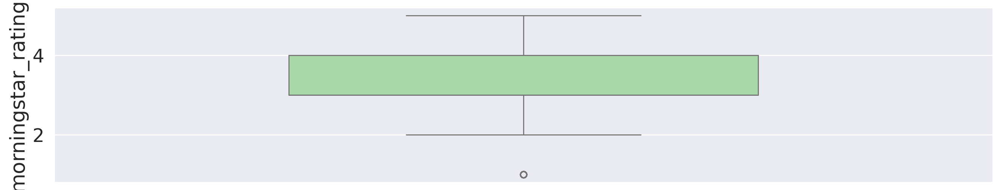

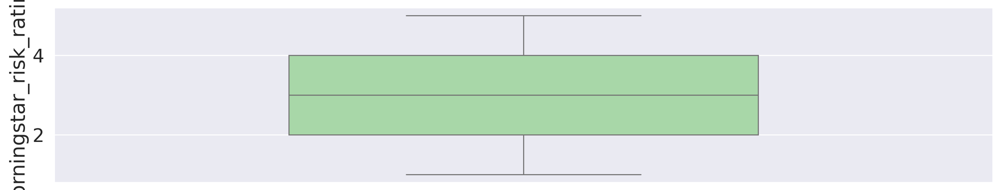

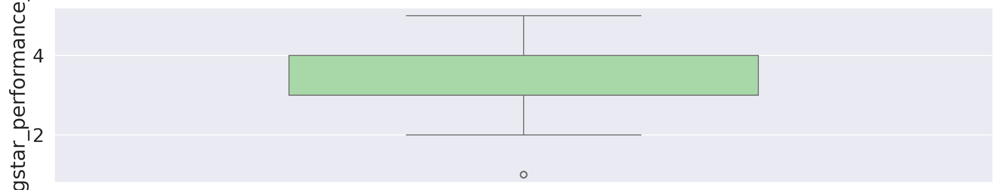

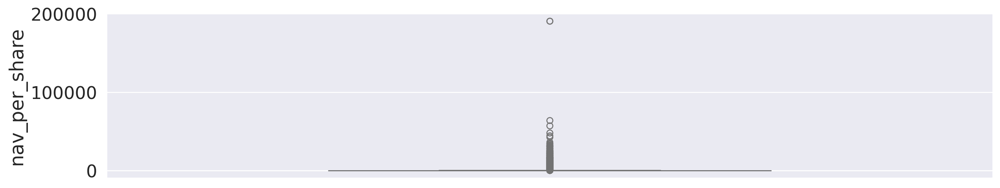

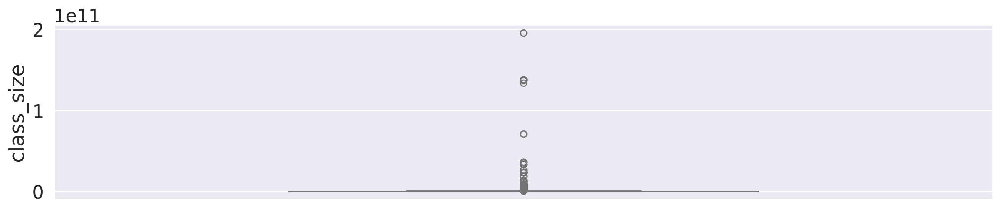

...

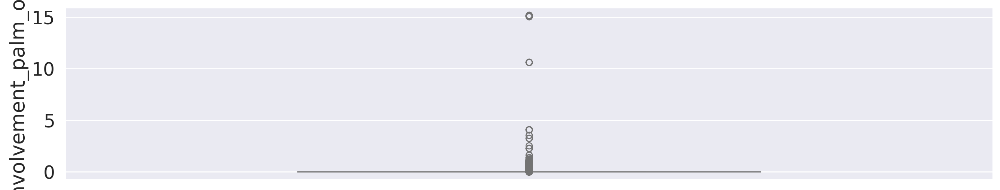

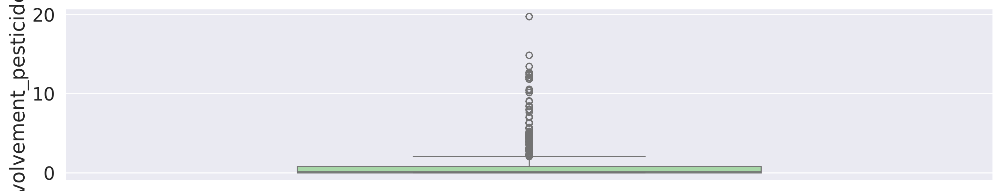

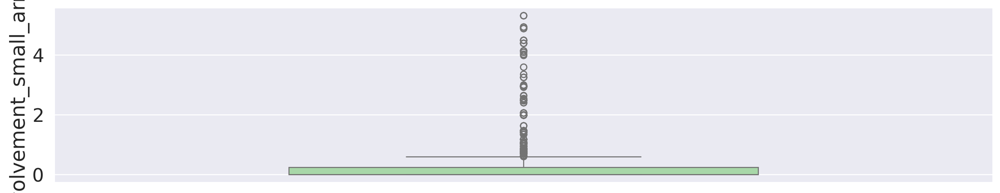

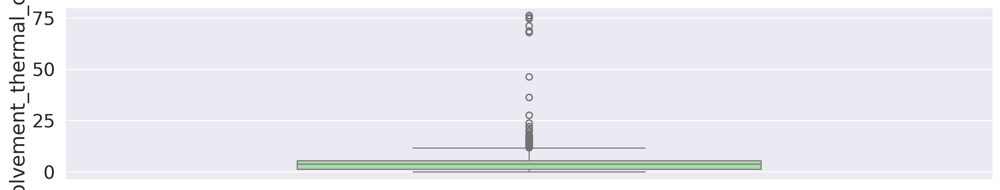

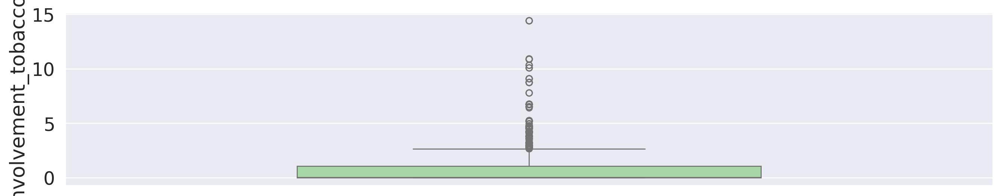

In [ ]:
# 3. Outlier Detection - (Box - Plot Method) - MF

# ax = fig.add_subplot(111)
sns.set_style('darkgrid')
sns.set_context("notebook", font_scale = 1.6)
plt.suptitle("Univariate Box Plots of Numerical Feratures", fontsize = 15, fontweight = 'bold')

for col in df_mf_num.columns:
    plt.figure(figsize = (16, 3))       # ---> plots figure for each iteration
    sns.boxplot(df_mf_num[col], color = "#90EE90", saturation = 0.50, width = 0.5)

fig.tight_layout()
# plt.show()


# Observations